# Data science and Machine Learning 
Academic year 2020/2021

Student: 
1. Nguyen Chi Cong
2. Nguyen Vu Anh Trung
3. Nguyen Quoc Khanh

---


## Data process on UCI Default of Credit Card Clients Dataset
https://archive.ics.uci.edu/ml/datasets/default+of+credit+card+clients

In [1]:
from IPython.display import display
from IPython.display import HTML
import IPython.core.display as di 
import pandas as pd
import numpy as np
import plotly.express as px
from plotly.subplots import make_subplots
import warnings
import os
import plotly.graph_objects as go
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
from matplotlib import pyplot as plt
from skimage import io
from scipy import stats
from sklearn.metrics import precision_recall_fscore_support, accuracy_score, classification_report
from sklearn.model_selection import GridSearchCV, ParameterGrid, StratifiedKFold
#from google.colab import files
import json
import random
from visualization import *

warnings.simplefilter("ignore")
scaler = MinMaxScaler()

# This line will hide code by default when the notebook is exported as HTML
di.display_html('<script>jQuery(function() {if (jQuery("body.notebook_app").length == 0) { jQuery(".input_area").toggle(); jQuery(".prompt").toggle();}});</script>', raw=True)

# This line will add a button to toggle visibility of code blocks, for use with the HTML export version
di.display_html('''<button onclick="jQuery('.input_area').toggle(); jQuery('.prompt').toggle();">Show/hide code</button>''', raw=True)


di.display_html("""

<style>
#customers {
  font-family: "Trebuchet MS", Arial, Helvetica, sans-serif;
  border-collapse: collapse;
  width: 100%;
}

#customers td, #customers th {
  border: 1px solid #ddd;
  padding: 8px;
  text-align: center;
}

.content:nth-child(even){background-color: #f2f2f2;}
.content:hover{background-color:#C7C9C7;}


#customers th {
  padding-top: 12px;
  padding-bottom: 12px;
  text-align: center;
  
  color: white;
}

.first{
    background-color: #4B6D80;
    font-size:20px;
}
.second{
    background-color: #71A4BF;
}

.third{
    background-color: #B1D0E8;
    color: white;
}

#customers a {
    color: black;
    padding: 10px 20px;
    text-align: center;
    text-decoration: none;
        text-decoration-line: none;
        text-decoration-style: solid;
        text-decoration-color: currentcolor;
        text-decoration-thickness: auto;
    display: inline-block;
    font-size: 16px;
    margin-left: 20px;
    
}

</style>

""", raw=True)


Show/hide code

In [2]:
di.display_html("""
<table id="customers">
    <thead class="first">
        <th colspan=5>Table of contents</th>
    <tbody>
        <tr>
            <td colspan=5 class="cell"><a href='#Description-of-the-dataset'>Description of the dataset</a></td>
        </tr>
        <tr>
            <td colspan=5 class="cell"><a href='#Data-cleaning-and-preprocessing'>Data cleaning and preprocessing</a></td>
        </tr>
        <tr>
            <td colspan=5 class="cell"><a href='#Anomaly-detection'>Anomaly detection</a></td>
        </tr>
        <tr>
            <td class="cell"><a href='#Z-score'>Z-score and Boxplot</a></td>
            <td class="cell"><a href='#Isolation-forests'>Isolation Forests</a></td>
            <td class="cell"><a href='#One-class-SVM'>One Class SVM</a></td>
            <td class="cell"><a href='#SVMDD'>SVMDD</a></td>
            <td class="cell"><a href='#Local-Outlier-Factor'>Local Outlier Factor</a></td>
        </tr>
        <tr>
            <td colspan=5 class="cell"><a href='#Distribution-and-Pairplot-matrix'>Distribution and Pairplot matrix</a></td>
        </tr>
        <tr>
            <td colspan=5 class="cell"><a href='#Correlation-among-features'>Correlation among features</a></td>
        </tr>
        <tr>
            <td colspan=5 class="cell"><a href='#Dimensionality-reduction'>Dimensionality reduction</a></td>
        </tr>
        <tr>
            <td colspan=5 class="cell"><a href='#Manage-dataset-imbalancing'>Manage dataset imbalancing</a></td>
        </tr>
        <tr>
            <td td colspan=3 class="cell"><a href='#A-variation:-k-means-SMOTE'>K-means SMOTE</a></td>
            <td td colspan=2 class="cell"><a href='#Undersampling-tecnique:-Cluster-Centroids'>Cluster Centroids</a></td>
        </tr>
        <tr>
            <td colspan=5 class="cell"><a href='#Cross-Validation'>Cross Validation</a></td>
        </tr>
        <tr>
            <td colspan=5 class="cell"><a href='#Algorithms'>Algorithms</a></td>
        </tr>
        <tr>
            <td class="cell"><a href='#Support-Vector-Machine'>Support Vector Machine</a></td>
            <td class="cell"><a href='#Decision-Tree'>Decision Tree and Random Forest</a></td>
            <td class="cell"><a href='#Ensamble-methods-and-boosting'>Ensamble methods and boosting</a></td>
            <td class="cell"><a href='#K-Nearest-neighbor'>K-Nearest neighbor</a></td>
            <td class="cell"><a href='#Logistic-regression'>Logistic regression</a></td>
        </tr>
        <tr>
            <td colspan=5 class="cell"><a href='#Comments-on-results'>Comments on results</a></td>
        </tr>
        <tr>
            <td colspan=5 class="cell"><a href='#References'>References</a></td>
        </tr>
    </tbody>
</table>
""", raw=True)

Table of contents 
 
 
 Description of the dataset 
 
 
 Data cleaning and preprocessing 
 
 
 Anomaly detection 
 
 
 Z-score and Boxplot 
 Isolation Forests 
 One Class SVM 
 SVMDD 
 Local Outlier Factor 
 
 
 Distribution and Pairplot matrix 
 
 
 Correlation among features 
 
 
 Dimensionality reduction 
 
 
 Manage dataset imbalancing 
 
 
 K-means SMOTE 
 Cluster Centroids 
 
 
 Cross Validation 
 
 
 Algorithms 
 
 
 Support Vector Machine 
 Decision Tree and Random Forest 
 Ensamble methods and boosting 
 K-Nearest neighbor 
 Logistic regression 
 
 
 Comments on results 
 
 
 References

# Exploratory data analysis
## Description of the dataset
 

This UCI dataset contains information on default payments, demographic factors, credit data, history of payment, and bill statements of credit card clients in Taiwan from April 2005 to September 2005.
The dataset can be found at [12].

The dataset is composed by 24 variables in total. The first variables contains information about the **user personal information**:

* *ID*: ID of each client, categorical variable
* *LIMIT_BAL*: Amount of given credit in New Taiwan dollars (includes individual and family/supplementary credit)
* *SEX*: Gender, categorical variable (1=male, 2=female)
* *EDUCATION*: level of education, categorical variable (1=graduate school, 2=university, 3=high school, 4=others, 5=unknown, 6=unknown)
* *MARRIAGE*: Marital status, categorical variable (1=married, 2=single, 3=others)
* *AGE*: Age in years, numerical variable

Others variables contains information about the **history of past payments**, the following attributes track the past monthly payment records, i.e. the delay of the payment referred to a specific month:

* *PAY_0*: Repayment status in September 2005 (-1=pay duly, 1=payment delay for one month, 2=payment delay for two months, … 8=payment delay for eight months, 9=payment delay for nine months and above)
* *PAY_2*: Repayment status in August 2005 (-1=pay duly, 1=payment delay for one month, 2=payment delay for two months, … 8=payment delay for eight months, 9=payment delay for nine months and above)
* *PAY_3*: Repayment status in July 2005 (-1=pay duly, 1=payment delay for one month, 2=payment delay for two months, … 8=payment delay for eight months, 9=payment delay for nine months and above)
* *PAY_4*: Repayment status in June 2005 (-1=pay duly, 1=payment delay for one month, 2=payment delay for two months, … 8=payment delay for eight months, 9=payment delay for nine months and above)
* *PAY_5*: Repayment status in May 2005 (-1=pay duly, 1=payment delay for one month, 2=payment delay for two months, … 8=payment delay for eight months, 9=payment delay for nine months and above)
* *PAY_6*: Repayment status in April 2005 (-1=pay duly, 1=payment delay for one month, 2=payment delay for two months, … 8=payment delay for eight months, 9=payment delay for nine months and above)

The following attributes instead consider the information related to the **amount of bill statement**, i.e. a monthly report that credit card companies issue to credit card holders in a specific month:

* *BILL_AMT1*: Amount of bill statement in September, 2005 (New Taiwan dollar)
* *BILL_AMT2*: Amount of bill statement in August, 2005 (New Taiwan dollar)
* *BILL_AMT3*: Amount of bill statement in July, 2005 (New Taiwan dollar)
* *BILL_AMT4*: Amount of bill statement in June, 2005 (New Taiwan dollar)
* *BILL_AMT5*: Amount of bill statement in May, 2005 (New Taiwan dollar)
* *BILL_AMT6*: Amount of bill statement in April, 2005 (New Taiwan dollar)

The last variables instead consider the **amount of previous payment** in a specific month:

* *PAY_AMT1*: Amount of previous payment in September, 2005 (New Taiwan dollar)
* *PAY_AMT2*: Amount of previous payment in August, 2005 (New Taiwan dollar)
* *PAY_AMT3*: Amount of previous payment in July, 2005 (New Taiwan dollar)
* *PAY_AMT4*: Amount of previous payment in June, 2005 (New Taiwan dollar)
* *PAY_AMT5*: Amount of previous payment in May, 2005 (New Taiwan dollar)
* *PAY_AMT6*: Amount of previous payment in April, 2005 (New Taiwan dollar)

The variable to predict is given by:
*  default.payment.next.month: indicate whether the credit card holders are defaulters or non-defaulters (1=yes, 0=no)


In [3]:
path = 'dataset/cleaned_credit_card.csv'
df = pd.read_csv(path).rename(columns={'PAY_0': 'PAY_1'}) # wrong column name PAY_0 setted to PAY_1
df = df.drop(axis=1, columns='ID')
df.reset_index()
df['default.payment.next.month'] = df['default.payment.next.month'].astype('category')
df.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,20000,2,2,1,24,2,2,-1,-1,-2,...,0,0,0,0,689,0,0,0,0,1
1,120000,2,2,2,26,-1,2,0,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,90000,2,2,2,34,0,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,50000,2,2,1,37,0,0,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,50000,1,2,1,57,-1,0,-1,0,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,0


# Data cleaning and preprocessing
The data cleaning process is the procedure of correcting or removing incomplete/inaccurate or incorrect portions of the dataset. As far as missing values displayed in the following table, there are no  `nan` values in any of the attributes.

In [4]:
s = ""
for i, n in df.isnull().sum().items():
    s+="<tr><td>" + i + "</td><td>" + str(n) + "</td></tr>"
    
# This line will hide code by default when the notebook is exported as HTML
di.display_html("""

<table>
    <thead>
        <th>Attribute</th>
        <th>Number of null or nan values</th>
    </thead>
    <tbody>
        """ + s + """
    </tbody>

</table>



""", raw=True)


LIMIT_BAL,0
SEX,0
EDUCATION,0
MARRIAGE,0
AGE,0
PAY_1,0
PAY_2,0
PAY_3,0
PAY_4,0
PAY_5,0
PAY_6,0


The presence of errors in the dataset can be addressed in two ways: or with the removal of the rows associated with or with a correction of the wrong attribute.
The latter strategy should be carried out in a careful manner as can introduce outliers and can decrease the performance of the classification algorithms, while the former may cause the deletion of a consistent number of  rows.

For these reasons the two alternatives are evaluated case by case according to the number of rows involved and the impact on the dataset.

In [5]:
df[['LIMIT_BAL','SEX', 'EDUCATION', 'MARRIAGE', 'AGE']].describe()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE
count,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000
mean,167484.322667,1.603733,1.853133,1.551867,35.485500
std,129747.661567,0.489129,0.790349,0.521970,9.217904
min,10000.000000,1.000000,0.000000,0.000000,21.000000
25%,50000.000000,1.000000,1.000000,1.000000,28.000000
50%,140000.000000,2.000000,2.000000,2.000000,34.000000
75%,240000.000000,2.000000,2.000000,2.000000,41.000000
max,1000000.000000,2.000000,6.000000,3.000000,79.000000


The attributes *LIMIT_BAL*, *SEX*, and *AGE* seem to be coherent with the description provided in the UCI website, while for *EDUCATION* and *MARRIAGE* there are some criticities.
As far as *EDUCATION* is concerned there are three categories not listed in the description of the dataset provided by the UCI website that corresponds to 0, 5, and 6;

While for *MARRIAGE* category from the function `.describe()` it is possible to notice that there is a minimum value equal to 0, that does not corresponds to any category previously described.

The total number of rows is 30000 and the number of rows associated with these anomalous values is limited: as shown in the first bar chart below the number of rows involved is equal to 280 + 51 + 14 (for EDUCATION values) + 54 (for MARRIAGE values)= 345 that represents the 1.15% of the total number of record.
Given the limited impact on the dataset, these rows are deleted.


In [6]:
summary = df['EDUCATION'].value_counts()
plot_bar(summary, 'EDUCATION', 'Number of rows for each EDUCATION category')

m = (df['EDUCATION'] == 0)|(df['EDUCATION'] == 6)|(df['EDUCATION'] == 5)
df = df.drop(df.EDUCATION[m].index.values, axis=0)

summary = df['EDUCATION'].value_counts()
plot_bar(summary, 'EDUCATION', 'Number of rows for each EDUCATION category with pre-processing')

In [7]:
summary = df['MARRIAGE'].value_counts()
plot_bar(summary, 'MARRIAGE', 'Number of rows for each MARRIAGE category')

m = (df['MARRIAGE'] == 0)
df = df.drop(df.MARRIAGE[m].index.values, axis=0)

summary = df['MARRIAGE'].value_counts()
plot_bar(summary, 'MARRIAGE', 'Number of rows for each MARRIAGE category with pre-processing')

As far as the attributes <i>PAY_*</i> is concerned, all of this attributes have a minimum value equal to -2, not included in the ranking. On the other hand the maximum value assumed is equal 8 so probabily it is necessary a re-scaling of the attribute. 
This is also suggested in several articles such as [1] .


In [8]:
df[['PAY_' + str(n) for n in range(1, 7)]] += 1
df[['PAY_' + str(n) for n in range(1, 7)]].describe()

,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6
count,29601.000000,29601.000000,29601.000000,29601.000000,29601.000000,29601.000000
mean,0.985068,0.868687,0.836560,0.781697,0.736022,0.712442
std,1.124503,1.199642,1.199793,1.172220,1.136217,1.152206
min,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
max,9.000000,9.000000,9.000000,9.000000,9.000000,9.000000


## One-hot encoding for categorical variables
Categorical variable such as *SEX*, *MARRIAGE* and *EDUCATION* are turned into one-hot variable in order to remove any orders that in this case have no meaning [4].

Given a feature $j$ the set of all possible value assumed by the $j$-th feature is the vocabulary set $v_j$ with cardinality $|v_j| = N$. The one-hot vector is a vector of lenght $(N-1)$ formed by all $0$ in all cells at the exception of a $1$ in the cell that identify the level of the attribute (i.e. the word of the dictionary).
If the level of an attribute is equal to $N$, the lenght of the one-hot vector is equal to $N-1$ because $1$ level can be obtained by "subtracting" all the other levels: the corresponging one hot vector is  composed by all zero elements. 

An integer encoding may impose some ordinal relationship that does not exist so for this reason a One Hot encoding is performed.

In [9]:
df['EDUCATION'] = df['EDUCATION'].astype('category')
df['SEX'] = df['SEX'].astype('category')
df['MARRIAGE'] = df['MARRIAGE'].astype('category')

df=pd.concat([pd.get_dummies(df['EDUCATION'], prefix='EDUCATION'), 
                  pd.get_dummies(df['SEX'], prefix='SEX'), 
                  pd.get_dummies(df['MARRIAGE'], prefix='MARRIAGE'),
                  df],axis=1)
df.drop(['EDUCATION'],axis=1, inplace=True)
df.drop(['SEX'],axis=1, inplace=True)
df.drop(['MARRIAGE'],axis=1, inplace=True)
df.head()

,EDUCATION_1,EDUCATION_2,EDUCATION_3,EDUCATION_4,SEX_1,SEX_2,MARRIAGE_1,MARRIAGE_2,MARRIAGE_3,LIMIT_BAL,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,0,1,0,0,0,1,1,0,0,20000,...,0,0,0,0,689,0,0,0,0,1
1,0,1,0,0,0,1,0,1,0,120000,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,0,1,0,0,0,1,0,1,0,90000,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,0,1,0,0,0,1,1,0,0,50000,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,0,1,0,0,1,0,1,0,0,50000,...,20940,19146,19131,2000,36681,10000,9000,689,679,0


## Min Max Scaling

Input variables may have different units so different scales; for this reason before drawing a boxplot, a `MinMaxScaler()` is applied in order to scale the features between a range (0, 1).
The transformation is given by the following formula:

\begin{equation}
X_{std} = \frac{(X - X_{min})}{(X_{max} - X_{min})}
\end{equation}

\begin{equation}
X_{scaled} = X_{std} * (max - min) + min
\end{equation}
Where:

$X_{min}$ is the minimum value on the column

$X_{max}$ is the maximum value on the column

$(min, max)$ are the extreme values of the range chosen, in this case $(0, 1)$

This transformation is applied on <b>numerical features</b> only as the categorical variables are transformed into one-hot vectors, that rescale the categorical variable in the range $(0,1)$.

In [10]:
scaler = MinMaxScaler()
df['LIMIT_BAL'] = scaler.fit_transform(df['LIMIT_BAL'].values.reshape(-1, 1))
df['AGE'] = scaler.fit_transform(df['AGE'].values.reshape(-1, 1))


for i in range(1,7):
    scaler = MinMaxScaler()
    df['BILL_AMT' + str(i)] = scaler.fit_transform(df['BILL_AMT' + str(i)].values.reshape(-1, 1))

for i in range(1,7):
    scaler = MinMaxScaler()
    df['PAY_AMT' + str(i)] = scaler.fit_transform(df['PAY_AMT' + str(i)].values.reshape(-1, 1))
    
for i in range(1,7):
    scaler = MinMaxScaler()
    df['PAY_' + str(i)] = scaler.fit_transform(df['PAY_' + str(i)].values.reshape(-1, 1))

In [11]:
from sklearn.model_selection import train_test_split

X_train_val, X_test, y_train_val, y_test = train_test_split(df[df.columns[:-1]], df['default.payment.next.month'], test_size=0.25, stratify=df['default.payment.next.month'])


---
# Anomaly detection

Anomaly detection tries to detect abnormal or unusual observations with outlier and novelty detection:
- we define *outlier detection* the procedure that seeks to determine which points have to be considered as outliers, as they are located in low density regions; this is a unsupervised procedures; 
- instead novelty points can form a dense cluster as long as they are in a low density region of the training data but considered as normal in this context; *novelty detection* is the task of classifying data points that differ in some respect from the data that are available during training.

In this section we seek to determine which points should be considered as outliers and discarded.

As shown in the following QQ-plots, data points in each features seem to be not normally distributed and for this reason the z-score method that will be presented is discarded and the oulier detection will be carried out through One Class SVM, SVMDD, Isolation forest and LOF.

Regarding One Class SVM, Isolation Forest and LOF, Sklearn provides a complete library for these algorithms. SVDD instead is implemented in the file svmdd.py by the means of Fico Xpress Optimization tool that provides a python library to solve the SVDD problem.

Outliers detected with these algorithms and deleted.


## Q-Q plot

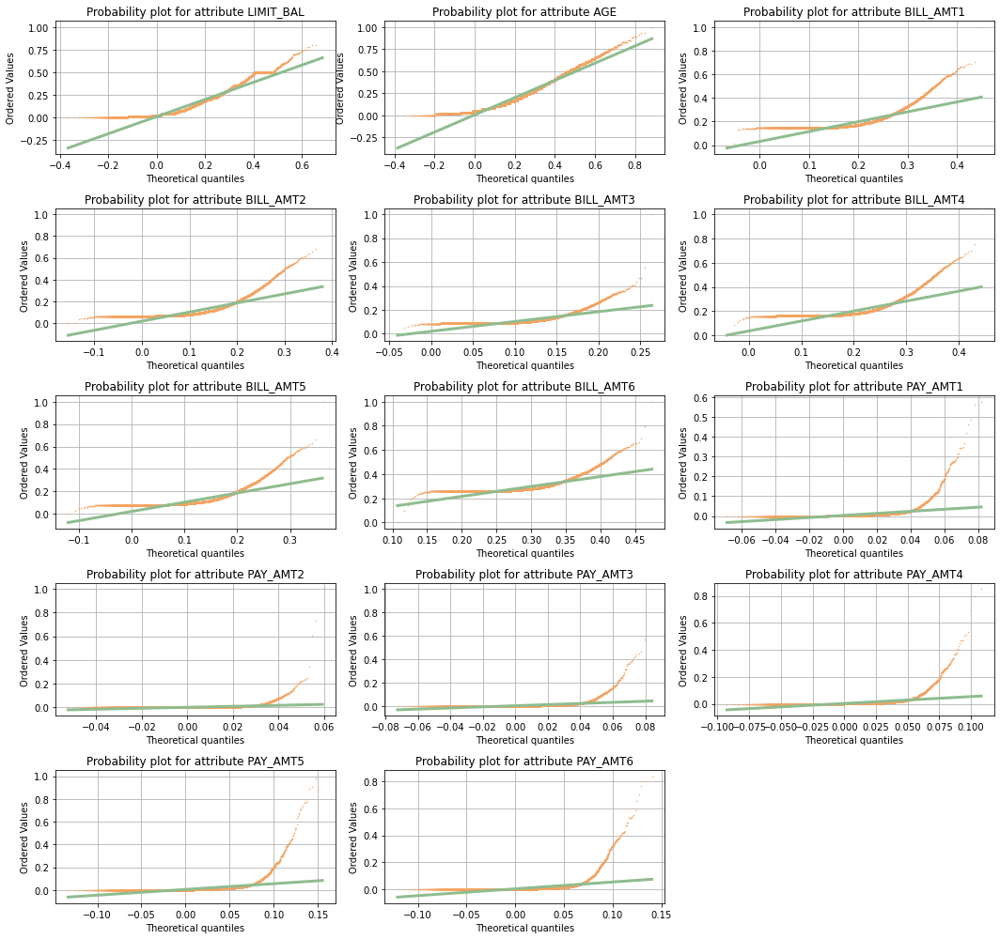

In [12]:
from scipy import stats

figs, axs= plt.subplots(5, 3, figsize=(15, 14))

i, j = 0, 0
d1 = ['BILL_AMT' + str(i) for i in range(1, 7)]
d2 = ['PAY_AMT' + str(i) for i in range(1, 7)]
d =  ['LIMIT_BAL', 'AGE'] + d1 + d2
for attribute in d:
    if j == 3:
        j = 0
        i = i+1
    stats.probplot(
        X_train_val[attribute], 
        dist="norm", 
        sparams = (X_train_val[attribute].mean(), X_train_val[attribute].std()),
        plot=axs[i, j]
    )
    
    axs[i, j].get_lines()[0].set_marker('.')
    axs[i, j].get_lines()[0].set_color('sandybrown')
    axs[i, j].get_lines()[0].set_markersize(1.0)
    axs[i, j].set_title('Probability plot for attribute ' + attribute)
    axs[i, j].grid()
    axs[i, j].get_lines()[1].set_linewidth(3.0)
    axs[i, j].get_lines()[1].set_color('darkseagreen')
    j = j+1
    
figs.tight_layout()
axs[4, 2].set_visible(False)
plt.show()


## Z-score
In [2] we determines how many standard deviations $x_i$ is far from the mean in case of normal distribution; the z-score is computed as:

\begin{equation}
z_{score} = \frac{(x_i - \mu_x)}{\sigma_x}
\end{equation}

If a $z_{score}$ of a point $x_i$ is more than a threshold, it means that the point is different, so distant from the other data points and it can be a possible outlier.
As displayed in the graphs above we can state that there's no evidence to believe that the features are normally distributed so this method is discarded.


## Boxplot
A boxplot [14] represents a 5-number summary of data:
  - *minimum*: the lowest data point excluding any outliers;
  - *maximum*: the largest data point excluding any outliers;
  - *first quartile*: the twenty-fifth percentile; 
  - *median*: the middle value of a dataset;
  - *third quartile*: the seventy-fifth percentile.

In the boxplot we define the <i>Interquartile range</i> (<i>IQR</i>) as is the distance between the upper and lower quartiles:

\begin{equation}
IQR = Q_3 - Q_1 = q_n(0.75) - q_n(0.25)
\end{equation}

A boxplot is made of two parts, a box and a set of whiskers: the box  goes from $Q_1$ to $Q_3$ and has an horizontal line drawn in the middle that indicates the median; from $Q_1$ and $Q_3$ two whiskers are drawn up to the largest observed point from the dataset that falls within a distance of $1.5$ times the $IQR$.

All the points above the maximum and below the minimum are considered outliers.

<img src="https://raw.githubusercontent.com/irenebenedetto/default-of-credit-card-clients/master/imgs/boxplot.png" alt="Boxplot" height="300px" width="600px" style="display: block;margin-left: auto;margin-right: auto;"/>

In [13]:
def detectOutliers(X, outlierConstant=1.5):
    a = np.array(X)
    upper_quartile = np.percentile(a, 75)
    lower_quartile = np.percentile(a, 25)
    IQR = (upper_quartile - lower_quartile) * outlierConstant
    quartileSet = (lower_quartile - IQR, upper_quartile + IQR)
    resultList = []
    for y in a.tolist():
      if y >= quartileSet[0] and y <= quartileSet[1]:
          resultList.append(1)
      else:
          resultList.append(-1)
    return np.array(resultList)

In [14]:
d1 = ['BILL_AMT' + str(i) for i in range(1, 7)]
d2 = ['PAY_AMT' + str(i) for i in range(1, 7)]
d = ['LIMIT_BAL', 'AGE'] + d1 + d2


data = pd.concat([y_train_val, X_train_val[d]], axis=1)
data = pd.melt(
    data,
    id_vars="default.payment.next.month",
    var_name = "features",
    value_name = "value",
)

fig = px.box(
    data,
    x = "features",
    y = "value",
    color = "default.payment.next.month",
    color_discrete_sequence=px.colors.qualitative.Set2,
)
fig.update_layout(
    xaxis_title= "Features",
    yaxis_title= "",
    title='Boxplot for the different attributes'
)
fig.show()

In [15]:
X_train_val['default.payment.next.month'] = y_train_val
#plot_boxplot('LIMIT_BAL', X_train_val)

box_outliers = detectOutliers(X_train_val['LIMIT_BAL'] )

for i in range(1,7):
  #plot_boxplot('BILL_AMT' + str(i), X_train_val)
  new_outliers = detectOutliers(X_train_val['BILL_AMT' + str(i)] )
  mask = np.array((box_outliers == -1)&(new_outliers == -1))
  box_outliers[mask == True] = -1
  box_outliers[mask == False] = 1
  


for i in range(1,7):
  #plot_boxplot('PAY_AMT' + str(i), X_train_val)
  new_outliers = detectOutliers(X_train_val['PAY_AMT' + str(i)] )
  mask = np.array((box_outliers == -1)&(new_outliers == -1))
  box_outliers[mask == True] = -1
  box_outliers[mask == False] = 1

X_train_val.drop('default.payment.next.month', axis=1, inplace=True)

## Isolation forests
As described in the paper [3] Isolation forests is an outliers detection method that makes use of ensamble of trees. 

Each tree is called *iTree* (*isolation Tree*) and the following procedure is carried out in order to build the *iTree*: until the tree reaches the maximum depth or up to when its leaves contains $1$ or $0$ samples, a random feature $q$ and a random splitting value $p$ from the maximum and the minimum value in $q$ are selected and the dataset is splitted according to this value.

This procedure is carried out for growing all the trees in the random forest.
We define the score $s(x, n)$ the following quantity:

\begin{equation}
s(x,n) = 2^{-\frac{E[h(x)]}{c(n)}}
\end{equation} 

where $h(x)$ of a point $x$ is the number of edges that $x$ traverses an *iTree* from the root to an external node, $c(n)$ a regularization factor that represents the esteem of the mean leght path, $E[h(x)]$ is the expected value of $h(x)$ from a collection of isolation trees.



A point is considered as outlier if his score is close to $1$, and that means that the $\frac{E[h(x)]}{c(n)}\rightarrow 0$: the idea behind is that if, on average, it is possible to isolate a data point $x$ with a number of splits lower that the average, then it is likely to be an outlier.

In [16]:
from sklearn.ensemble import IsolationForest

isolation_forest = IsolationForest()
is_outliers = isolation_forest.fit_predict(X_train_val)
score_sample =isolation_forest.score_samples(X_train_val)
offset = isolation_forest.offset_
title = "Score of each data point in Isolation forest"
x_position_outlier_ann = 487
y_position_outlier_ann = -0.57

plot_score_outliers(score_sample, offset, title, x_position_outlier_ann, y_position_outlier_ann)

## One class SVM

This algorithm typically sensitive to outliers and thus does not perform very well for outlier detection. 
One Class SVM is best suited for novelty detection when the training set is not contaminated by outliers. But, as described in [6] ([Comparing anomaly detection algorithms for outlier detection on toy datasets](https://scikit-learn.org/stable/auto_examples/miscellaneous/plot_anomaly_comparison.html#sphx-glr-auto-examples-miscellaneous-plot-anomaly-comparison-py)), outlier detection in high-dimension with One-class SVM can return acceptable results, once found a good configuration of hyperparameters.

As explained in [7] this algorithm trains an SVM in which it seeks to have all data points on one side of the plane cutted by the SVM hyperplane and the origin $x_0$ on the other side. The One class SVM problem can be stated as follows:

\begin{equation}
\min_{w, \xi_i, \rho} \frac{1}{2} || w ||^2 + \frac{1}{\nu l}\sum_i \xi_i - \rho
\end{equation}
\begin{equation}
s.t. (w \cdot \Phi(x_i)) \ge \rho - \xi_i,  \xi_i \ge 0
\end{equation}

where $w$, $\rho$ are respectlivly the slope and the intercept for the hyperplane, $l$ is the number of data points, $\nu$ is an hyperaparameter that regulates a trade off between the regularization term (i.e. the robustness of the margin) and the number of mistakes allowed by the slack variable $\xi_i$. 

The outliers are represented by the data points that corresponds to positive $\xi_i$.

High value of $\nu$ allows more mistakes, making more robust the margin of the hyperplane, while for small values the mistakes assume more importance.
As usual, kernels can be applied to this version of SVM. 

<img src="https://raw.githubusercontent.com/irenebenedetto/default-of-credit-card-clients/master/imgs/one_class.png" alt="One class SVM" height="300px" width="600px" style="display: block;margin-left: auto;margin-right: auto;"/>



In [17]:
from sklearn.svm import OneClassSVM
nu = 0.1
one_class_svm = OneClassSVM(nu = nu, kernel='poly')
ocsvm_outliers = one_class_svm.fit_predict(X_train_val)

## SVMDD
As described in the paper [9] and [10], this method can be applied both in unsupervised and in supervized way, for outlier detection or novelty detection.

This algoritm is similar to the previous one: it is an SVM based on one-class classification, that seek for identifying the smallest hypersphere (with radius $r$, and center $c$) that contains all the data points. The hard-problem formulation might be relaxed by introducing slack variables $\xi$: in this case not all the data points must be included in the hypersphere. So the SVM One Class problem becomes:

\begin{equation}
\min_{r, \xi_i}{r^2 + \frac{1}{\nu n}\sum_{i}\xi_i}
\end{equation}
\begin{equation}
s.t. || \Phi (x_i) - c|| \le r^2 + \xi_i   
\end{equation}
\begin{equation}
\forall i = 1, ..., n
\end{equation}
The data points not included in the hypersphere are the outliers.

In [18]:
from sklearn.svm import OneClassSVM
nu = 0.2
one_class_svm = OneClassSVM(nu = nu)
svdd_outliers = one_class_svm.fit_predict(X_train_val)

## Local Outlier Factor

In [15] LOF is described as an outliers detection method based on the concept of local density. We define the *k-distance* of a point $p$ the distance from $p$ to the $k$-th nearest neighbor that belongs to $N_k(p)$, the set of $k$ nearest neighbors.
We define also the <b>reachability distance</b> of the point $p$ from the point $o$ the quantity:
\begin{equation}
\operatorname{reach-dist}_k(p, o) = \max \{ \operatorname{k-distance}(o), d(p, o) \}
\end{equation}

This distance is higher if the $\operatorname{k-distance}(o)$ is greater than the quantity $d(p, o)$ that is the true distance between the two points: consequently, sparse points will and up to have bigger *k-distance*. The reachability distance is employed in the definition of <b>local reachability density</b> of $p$ that is:

\begin{equation}
\operatorname{lrd}_k(p) = 1/\left ( \frac{\sum_{o \in N_k(p)} \operatorname{reach-dist}_k(p, o) }{|N_k (p)|} \right )
\end{equation}

that is the inverse of the average distance at which $p$ can be reached from its neighbors: a high $\operatorname{reach-dist}_k(p, o)$ may signify that in average the neighbors of a point $p$ are probably isolated (because their reachability distance are high) , so the distance from the neighbors of the point in analysis and $p$ is particularly high.
With the local reachability density it is possible to compute the <b>local outlier factor</b> that is the following:

\begin{equation}
\operatorname{LOF}_k(p) = \frac{\sum_{o \in N_k(p)} \frac{\operatorname{lrd}_k(o) }{\operatorname{lrd}_k(p) } }{|N_k(p)|}
\end{equation}

<img src="https://raw.githubusercontent.com/irenebenedetto/default-of-credit-card-clients/master/imgs/lof.png" alt="LOF" height="300px" width="600px" style="display: block;margin-left: auto;margin-right: auto;"/>

- $\operatorname{LOF}_k(p)$~$1$ means that the point $p$ has the same density of his neighbors and probably is not an outlier;
- $\operatorname{LOF}_k(p) < 1$ means that the density of $p$ is large, so that the reachability distace (i.e. the distance at which $p$ can be reached from its neighbors) is small, than the point $p$ is an *inlier*;
- $\operatorname{LOF}_k(p) > 1$ means that the mean reachability distance of the neighbors of the point $p$ prevails over the distance at which $p$ can be reached by them: the neighbors' regions are more dense than the one in which $p$ lives so it can be considered as *outlier*.


In [19]:
from sklearn.neighbors import LocalOutlierFactor
lof = LocalOutlierFactor(n_neighbors=200)
lof_outliers = lof.fit_predict(X_train_val)
score_sample = lof.negative_outlier_factor_
offset = lof.offset_

title = "Score of each data point in Local Outlier Factor"
x_position_outlier_ann = 896
y_position_outlier_ann = -1.62

plot_score_outliers(score_sample, offset, title, x_position_outlier_ann, y_position_outlier_ann)

In [20]:
num_is_outliers = len(np.where(is_outliers == -1)[0])
num_oc_outliers = len(np.where(ocsvm_outliers == -1)[0])
num_svdd_outliers = len(np.where(svdd_outliers == -1)[0])
num_lof_outliers = len(np.where(lof_outliers == -1)[0])

s = f'Outliers with Isolation Forest: {num_is_outliers}<br>Outliers with One Class SVM: {num_oc_outliers}'
s += f'<br>Outliers with LOF: {num_lof_outliers}'
s += f'<br>Outliers with SVMDD: {num_svdd_outliers}'

mask = (is_outliers == -1)&(ocsvm_outliers == -1)&(lof_outliers == -1)
#mask = (is_outliers == -1)&(ocsvm_outliers == -1)&(lof_outliers == -1)&(svdd_outliers == -1)

common_outlier = np.sum(mask)
s += f'<br><br>The previous algorithms indentify {common_outlier} outliers in common.'
di.display_html("""

<p style='margin-bottom: 1em;font-size:15px'>
    """ + s + """
</p>
""", raw=True)
X_train_val['default.payment.next.month'] = y_train_val

X_train_val.drop(X_train_val[mask].index, axis=0, inplace=True)
y_train_val = X_train_val['default.payment.next.month']
X_train_val.drop('default.payment.next.month', axis=1, inplace=True)

Outliers with Isolation Forest: 2326 Outliers with One Class SVM: 2220 Outliers with LOF: 3971 Outliers with SVMDD: 4443 The previous algorithms indentify 62 outliers in common.

# Distribution and Pairplot matrix
In order to identify if there might be possible relationships among non categorical variables we plot the scatter matrix.
This matrix contains, for each combination of the numeric variables, a small scatterplot that displays the distribution of data points among the two variables considered, separated by the two classes.

The limit of this visualization is that each scatter plot in the matrix visualizes the relationship between a pair of variables only and it is not able to convert the strenght of a relationship in a quantitative form.

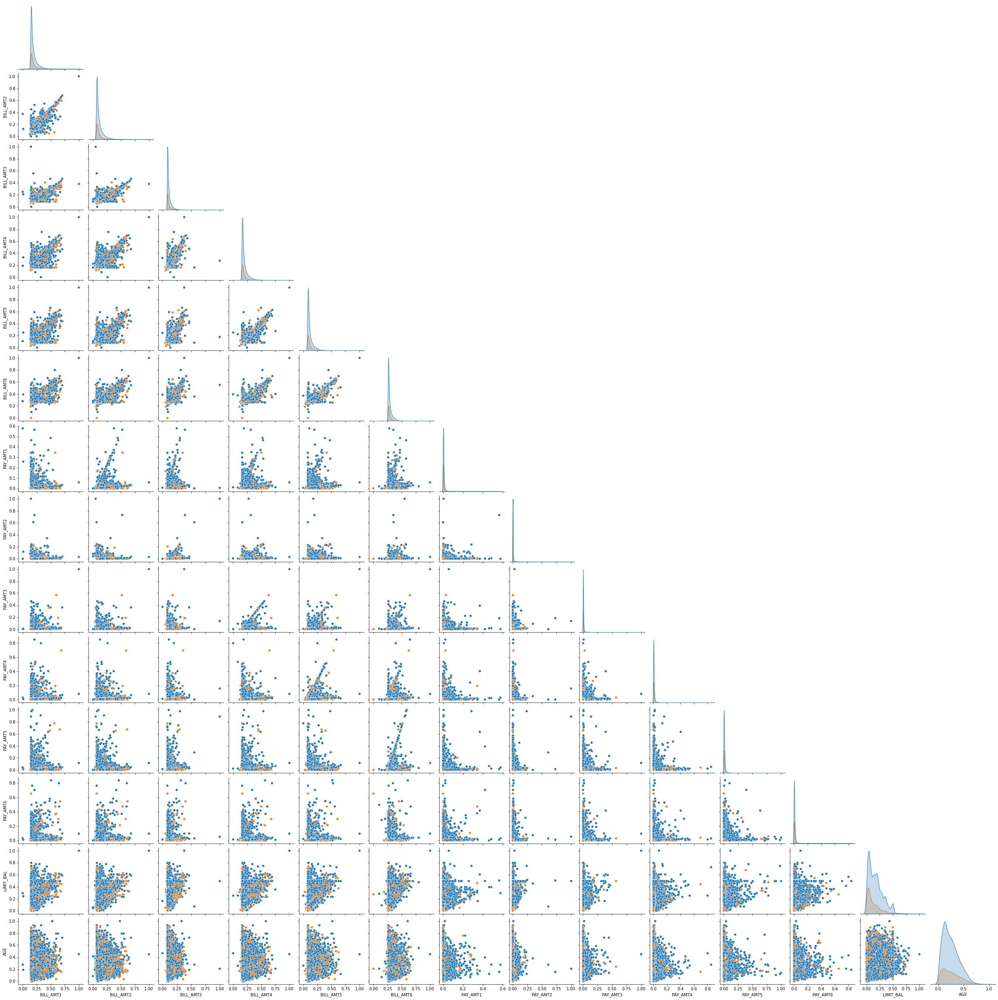

In [21]:
#d1 = ['PAY_' + str(n) for n in range(1, 7)]
d2 = ['BILL_AMT' + str(n) for n in range(1, 7)]
d3 = ['PAY_AMT' + str(n) for n in range(1, 7)]
dimensions = d2 + d3 +['LIMIT_BAL','AGE','default.payment.next.month']
X_train_val['default.payment.next.month'] = y_train_val
pairpl = sns.pairplot(X_train_val[dimensions], hue='default.payment.next.month', diag_kind='kde', corner=True);
pairpl._legend.remove()


X_train_val.drop('default.payment.next.month', axis=1, inplace=True)

# Correlation among features

If two numerical features are perfectly correlated, then one doesn't add any additional information (it is determined by the other).
In order to determine if there are features correlated, we plot the correlation matrix. The population correlation coefficient $\rho_{X,Y}$ between two random variables $X$ and $Y$ with expected values $\mu _{X}$ and $\mu _{Y}$ and standard deviations $\sigma _{X}$ and $\sigma _{Y}$ is defined as:

\begin{equation}
\rho_{X,Y} = corr(X, Y) = \frac{cov(X, Y)}{\sigma_X\sigma_Y} = \frac{E[(X-\mu_X)(Y-\mu_Y)]}{\sigma_X\sigma_Y}
\end{equation}

- A correlation coefficient of 1 means that for every positive increase in one variable, there is a positive increase of a fixed proportion in the other. 
- A correlation coefficient of -1 means that for every positive increase in one variable, there is a negative decrease of a fixed proportion in the other. 
- A correlation coefficient equal to zero means that for every increase, there isn’t a positive or negative increase, so they aren't correlated.

There are some reasons for which removing correlated features is important:
- Make the algorithm simpler and faster: firstly, less features may improve the algorithm in terms of speed; in second instance, we may consider the problem known as the *curse of dimensionality* (points  in  high  dimensional  spaces are more isolated and the probability to capture a point becomes small when the number of dimensions increases). 
- Correlated features are not so much informative: they do not provide any additional information.

The sample covariance (the counterpart that is given by the realizations) is computed in the following way:

\begin{equation}
\hat{\rho}_{X,Y} = \hat{corr}(X, Y) = \frac{\sum_{i = 1}^n (x_i - \bar{x})(y_i - \bar{y})}{s_X s_Y(n-1)} 
\end{equation}

where $s_X^2$ and $s_Y^2$ are the sample variances, $\bar{x}$ and $\bar{y}$ are the sample means of the two random variable.

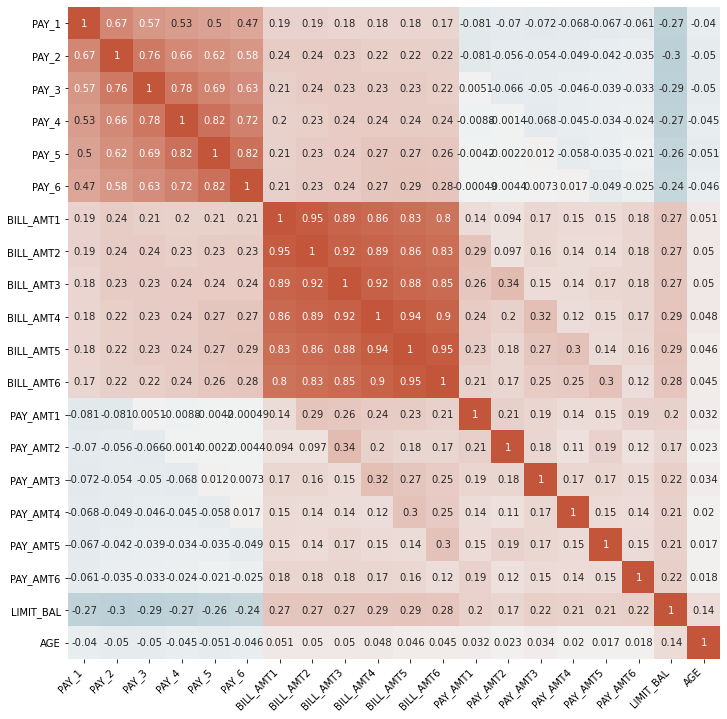

In [22]:
dimensions = ['PAY_' + str(n) for n in range(1, 7)] + dimensions
corr = X_train_val[dimensions[:-1]].corr()
fig, ax = plt.subplots(figsize=(12,12)) 
sns.heatmap(
    corr, 
    vmin = -1, 
    vmax = 1, 
    center = 0,
    cmap = sns.diverging_palette(220, 20, n=200),
    square = True,
    ax = ax,
    annot = True,
    cbar = False

)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right'
);


As displayed in the correlation matrix, there exist an high positive correlation among the <i>BILL_AMT</i> features: in order to remove correlated features a Principal component analysis is performed.

---

# Dimensionality reduction 

With a dimensionality reduction we take data points in a high dimensional space and we map them into a new space whose dimensionality is smaller.
The reasons for which the dimensionality reduction is required are the following:
- high dimensional data may cause high computational costs;
- high dimensionality might lead to poor generalization;
- can be used for interpretability of the data, for illustraton purposes for example.

## Principal component analysis

Given $x_1,...,x_m$ be $m$ vectors in $\mathbb {R}^d$ forming the matrix $X \in \mathbb {R}^{d,m}$, vectors centered in their mean, a matrix $W \in \mathbb{R}^{n, d}$ where $n < d$ that performs a mapping in the lower dimensional space, a second matrix $U \in \mathbb{R}^{d, n}$ used to recover the original vector $x$ from his compressed version $\tilde x_i = Uy_i$ where $y_i = Wx_i$.

In the Principal Component Analysis (PCA) [13] we aim to find the compression matrix $W$ such that the total squared distance between the original and recovered vectors is minimal, solving the problem:
\begin{equation}
\underset{W \in \mathbb{R}^{n, d}, U \in \mathbb{R}^{d, n} }{\operatorname{argmin}} \sum_{i = 1}^m || x_i-UWx_i||_2^2
\end{equation}

Let $\Sigma = \sum_{i = 1}^m x_i x_i^T$ be a matrix, simmetric and positive semidefinite that can be decomposed as $\Sigma = UDU^T$ it is possible to demonstrate that the PCA problem's solution is the matrix $U$, whose columns are the $n$ eigenvectors of $\Sigma$, denoted as $u_1, ..., u_n $, corresponding to the largest $n$ eigenvalues.

It can be shown that the matrix $\frac{1}{m-1}\Sigma$  corresponds to the empirical variance-covariance matrix, so we can interpret the PCA as a tecnique to find the **directions of maximal variance**, directions given by the eigenvectors corresponding to the largest eigenvalues of $\Sigma$.

So with the PCA we can project the data points in the direction of the maximal variance: PCA takes the first $n$ most important component of $x_i$.
The new directions, given by the eighenvectors that corresponds to the largest $n$ eighenvalues of the variance covariance matrix, are called *principal components directions of* $X$.

The principal components are **uncorrelated** with each others and this property is given by the fact that for construnction the directions of the components are orthogonal with each other.
The optimal transformation of the data is obtained by projecting data onto the components found solving the problem, so it is given by $z_i = U^T x_i$. 

To understand the strenght of the new principal components we can compute the *proportion of explained variance*, that is defined as:

\begin{equation}
\frac{\sum_{i = 1}^n Var(z_i)}{\sum_{i = 1}^d Var(x_i)} = \frac { \sum_{i = 1}^m z_i z_i^T}{\sum_{i = 1}^m x_i x_i^T}
\end{equation}

where $m$ is the number of data, $d$ is the dimension of the starting space,  $z_i$ is the projection of the point $x_i$ in the lower $n$-th dimensional space.
The complete algorithm that is presented in [12] is the following:


<img src="https://raw.githubusercontent.com/irenebenedetto/default-of-credit-card-clients/master/imgs/pca_alg-png.png" alt="PCA algorithm" height="300px" width="600px" style="display: block;margin-left: 0;margin-right: auto;"/>

In [23]:
from sklearn.decomposition import PCA

pc = 11
explainend_var = []

pca = PCA(n_components=len(X_train_val.columns.values))
pca.fit(X_train_val)

fig = go.Figure()
fig.update_layout(
    title = "Cumulative and variance explained with different number of component",
    xaxis_title= "Number of principal component",
    yaxis_title= "Variance explained",
)


fig.add_annotation(
    x=pc,
    y=0,
    text = 'Principal component '+ str(pc),
    showarrow=True,
    arrowsize=1,
)
fig.add_annotation(
    x=pc,
    y=1,
    text = 'Principal component '+ str(pc),
    showarrow=True,
    arrowsize=1,
    
)


fig.add_trace(
    go.Scatter(
        x=[i for i in range(1, len(X_train_val.columns.values))], 
        y=np.cumsum(pca.explained_variance_ratio_),
        mode="lines+markers+text",
        #text=[round(v*100, 1) for v in np.cumsum(pca.explained_variance_ratio_)],
        name='total variance explained',
        textposition="bottom center",
        hovertemplate = "Cumulative explained variance%{y:.2f}<br>Principal Component %{x})",
        textfont=dict(
        size=12,
        ),
        marker=dict(
          color='rgb(229,196,148)',
          size=8,
          ),
        line = dict(
            width=4
            )
        )
    )

fig.add_trace(
    go.Scatter(
        x=[i for i in range(1, len(X_train_val.columns.values))], 
        y=pca.explained_variance_ratio_,
        mode="lines+markers",
        name='variance explained by the single component',
        
        marker=dict(
          color='rgb(102,194,165)',
          size=8,
          ),
        line = dict(
            width=4
            )  
    )
)


fig.update_xaxes(showspikes=True)
fig.update_yaxes(showspikes=True)



fig.show()

The graph above is relative to the <b>proportion of explained variance</b>: the green line represents the proportion of variance explained by each principal component, in increasing order.
The line in yellow instead is the cumulative amount of proportion of variance explained by the principal components on the left.

This graph is useful in the decision regarding the number of components to keep: the firsts $11$ principal components are able to capture almost the hole variance of the data points and for this reason we decided to keep these number.

In [24]:
pca = PCA(n_components=pc)
pca.fit(X_train_val)
X_train_val.index = pd.RangeIndex(start=0, stop=len(X_train_val), step=1)
X_15d_train_val = pd.DataFrame(pca.transform(X_train_val))
X_15d_test = pd.DataFrame(pca.transform(X_test))
X_15d_train_val.columns = ['PC' + str(i) for i in range(1, pc+1) ]
X_15d_test.columns = ['PC' + str(i) for i in range(1, pc+1) ]
X_15d_train_val.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11
0,-0.441469,1.084898,0.480268,0.856075,-0.224116,-0.099800,-0.088682,0.007117,-0.020996,-0.002415,-0.046492
1,1.156555,0.554435,0.374745,-0.189777,0.109302,-0.000179,0.011305,-0.001394,-0.025170,0.105021,0.005506
2,1.146806,0.563949,0.369023,-0.172484,0.207494,-0.033665,0.140212,-0.055725,-0.148591,0.021667,-0.004732
3,0.725098,-0.802510,0.505295,-0.206420,-0.370258,-0.033127,0.039273,-0.015922,0.019288,0.044891,0.038658
4,-0.055364,0.968156,0.935828,-0.429396,-0.141464,-0.086400,-0.089033,0.025017,0.071104,-0.030389,-0.041342


---
# Manage dataset imbalancing

In machine learning, it is difficult to train an effective learning model if the class distribution in a given training data set is imbalanced.
The overall accuracy may be high, but when computing the accuracy separatly for each class it is possible to notice that the percentage of data points that belongs to the minority class correcly classified is lower than the one computed over the majority class.
To tackle this problem one can adopt two different strategies
- <b>Oversampling</b> the minority class;
- <b>Undersampling</b> the majority class.
With the following code it is possible to verify that there is an high imbalance towords the class 0, which is present in almost the 80% of the dataset. This suggest to further adopt a tecnique in order to rebalance the classes.

In [25]:
l0 = y_train_val[y_train_val== 0].count()
l1 = y_train_val[y_train_val== 1].count()

s = f"There are: <ul><li>{l0} rows labelled with 0 (<b>{round(l0/(l1+l0)*100)}%</b>);</li><li> {l1} rows labelled with 1 (<b>{round(l1/(l1+l0)*100)}%</b>).</li></ul>"


di.display_html("""

<p style='margin-bottom: 1em;font-size:15px'>
    """ + s + """
</p>
""", raw=True)

There are: 17200 rows labelled with 0 ( 78.0% ); 4938 rows labelled with 1 ( 22.0% ).

In this analysis, thanks to the fact that we have $30000$ at disposal we decided to adopt and compare the results obtained by applying both the tecniques. For the first strategy we use the <b>SMOTE</b> algorithm, while for the second <b>Cluster Centroid</b>.

## SMOTE

The Synthetic Minority Oversampling Technique [8] (SMOTE) generates synthetic points by introducing new observations taken along the line segments joining any or all the points that belong to the class to rebalance.

<img src="https://raw.githubusercontent.com/irenebenedetto/MML_tesina/master/imgs/smote_vis.png" alt="SMOTE Visualization" height="300px" width="600px" style="display: block;margin-left: auto;margin-right: auto;"/>

In other words, given a limited set of data points that belong to the class that we wish to augment, we trace high-dimensional lines connecting the data points and we draw new samples from such lines.

The algorithm is the following:

<img src="https://raw.githubusercontent.com/irenebenedetto/default-of-credit-card-clients/master/imgs/smote_alg.png" alt="SMOTE algorithm" height="300px" width="600px" style="display: block;margin-left: 0;margin-right: auto;"/>


## A variation: k-means SMOTE
The algorithm is composed by three steps:
- in the <b>clustering</b> step, the input space is clustered into $k$ groups using k-means algorithm;
- In the <b>filtering</b> step the algorithm leaves out the clusters that have an low proportion of the minority class for oversampling; then it distributes the number of synthetic samples to generate, assigning more samples to clusters where minority samples are sparsely distributed;
- In the last step, the <b>oversampling</b>, SMOTE is applied in each selected cluster to achieve the target number computed in the previous step;

To determine the distribution of samples to be generated, filtered clusters are assigned sampling weights between zero and one.
For each filtered cluster, calculate the Euclidean distance between each pair of data points, ignoring data points lebelled with the majority class and compute the mean distance within each cluster;

To obtain a measure of density, divide each cluster’s number of minority instances by its distance previously computed, raised to the power of the number of features; the inverse will be the measure of *sparsity*;

The sampling weight of each cluster is defined as the cluster’s sparsity  divided by the sum of all clusters’ sparsity factors. The sampling weight of a cluster can be multiplied by the overall number of samples to be generated to determine the number of samples to be generated in that cluster.

The second step (*filtering*) is motivated by the fact that the algorithm seeks to oversample only clusters dominated by the minority class, as applying SMOTE inside minority areas is less susceptible to noise generation. 
For this reason, K-means SMOTE is appliyed.



In [26]:
"""if not os.path.isdir('imbalancedlearn'):
  !git clone https://github.com/scikit-learn-contrib/imbalanced-learn.git
  !mv 'imbalanced-learn' 'imbalancedlearn'
  from imalancedlearn.under_sampling import KMeansSMOTE
  """

"if not os.path.isdir('imbalancedlearn'):\n  !git clone https://github.com/scikit-learn-contrib/imbalanced-learn.git\n  !mv 'imbalanced-learn' 'imbalancedlearn'\n  from imalancedlearn.under_sampling import KMeansSMOTE\n  "

In [27]:
from imblearn.over_sampling import SMOTE , KMeansSMOTE

def oversample_dataset(X_train, y_train):

    s = f"<br>Number of instances in the training set before the rebalancing operation: {len(X_train)}"
    #oversample = SMOTE()
    oversample = KMeansSMOTE(cluster_balance_threshold=0.00001)
    X_train_smote, y_train_smote = oversample.fit_resample(X_train, y_train)

    s += f"<br>Number of instances in the training set after the rebalancing operation: {len(X_train_smote)}"
    
    l0 = len(y_train_smote[y_train_smote == 0])
    l1 = len(y_train_smote[y_train_smote == 1])
    
    s += f"<br>There are {l0} rows labelled with 0 ({round(l0/(l1+l0)*100)}%), {l1} rows labelled with 1 ({round(l1/(l1+l0)*100)}%)"
    return X_train_smote, y_train_smote, s


## Undersampling tecnique: Cluster Centroids

Given the large amount of data available, we also try an undersampling tecnique called Cluster Centroids.

All the undersampling tecniques that make use of K-means algorithm proceed as follows.
After finding the cluster centroids on the majority class points, the algorithm selects the instances belonging to the cluster (labelled with the majority class), which are furthest from the cluster centroid in feature space.
These data points are considered as the most unimportant instance. 
On the contrary, the instance belonging to the majority class, that is nearest to the cluster centroid in feature space, is considered to be the most important instance. 
In this way, instances belonging to the majority class are removed on the basis of their importance.

For *Cluster Centroid* in particular, given two class which has respectively $N$ and $M$ data points with $N<M$, the algoritm trains a K-Means on points labelled with the majority class label, with $k = N$, the cardinality of the set of minority data points.
Then for each cluster, it replace the data points of the majority class with a new point whose coordinates correspond to the cluster centroid's coordinates.

<img src="https://raw.githubusercontent.com/irenebenedetto/default-of-credit-card-clients/master/imgs/smote_vs_cc.png" alt="SMOTE vs Cluster Centroid" height="600px" width="900px" style="display: block;margin-left: 0;margin-right: auto;"/>

In [28]:
from imblearn.under_sampling import ClusterCentroids

def undersample_dataset(X_train, y_train):

    s = f"<br>Number of instances in the training set before the rebalancing operation: {len(X_train)}"
    oversample = ClusterCentroids()
    
    X_train_cc, y_train_cc = oversample.fit_resample(X_train, y_train)

    s += f"<br>Number of instances in the training set after the rebalancing operation: {len(X_train_cc)}"
    
    l0 = len(y_train_cc[y_train_cc == 0])
    l1 = len(y_train_cc[y_train_cc == 1])
    
    s += f"<br>There are {l0} rows labelled with 0 ({round(l0/(l1+l0)*100)}%), {l1} rows labelled with 1 ({round(l1/(l1+l0)*100)}%)"
    return X_train_cc, y_train_cc, s

# Metrics to evaluate a classifier

The metrics adopted to evaluate the performance of a classifier are the following:
- *Accuracy score*: it is the ratio of correct predictions (TP$^1$ + TN$^2$)  over the total number of data points classified (TP + FN$^4$ + FP$^3$ + TN).
- *Precision*, or positive predictive value, is the number of TP divided by the total number of elements labelled with $1$ (TP + FP), it highlights how valid the results are;
- *Recall*: is the number of TP divided by the total number of elements that actually belong to the positive class (TP + FN), it shows how complete the predictions are;
- *F-measure*, that is the harmonic of precision and recall mean given by the following expression:

\begin{equation}
F = 2 \cdot \frac{precision \cdot recall}{precision + recall}
\end{equation}


As far as accuracy is concerned, in case of class imbalance, this metric may return an high score even if the minority class is not correcly classified.
In our case the minority class is the positive one so precision, recall and f-measure are able to measure the goodness of the classifier [10].
In this analysis we focus our attention in detecting which customer may be defaults clients, and the positive class captures the attention of the classifier.

The Sklearn function `classification_report()` returns the results, in terms of accuracy, precision, recall, and f-measure for all the classes considered.


---


$^1$  *TP*, true positive = the number of items correctly labeled as belonging to the positive class

$^2$  *TN*, true negative = the number of items correctly labeled as belonging to the negative class

$^3$  *FP*, false positive = the number of items wrongly labeled as belonging to the positive class

$^2$  *FN*, false negative = the number of items wrongly labeled as belonging to the negative class



---
# Cross Validation
It is a resampling method that allows to repeteadly drawing samples from a training set, in order to have a better estimate of the evaluation score used.

With the cross-validation technique we aim to verify if the model is able predict labels for data points that it hasn't seen so far.
The complete dataset is divided into $k$ subsets (folds):
- $k-1$ folds will be used to train the model, all togheter compose the *training set*;
- one fold composes the *validation set*, on which we evaluate the performance of the model.

This operation is repeated $k$ times in order to reduce the variability, and at every round the validation subset changes. At the end, the $k$ estimates of model's predictive performance are averaged.

<img src="https://raw.githubusercontent.com/irenebenedetto/default-of-credit-card-clients/master/imgs/kfoldcv.png" alt="CV" height="300px" width="600px" style="display: block;margin-left: auto;margin-right: auto;"/>

The special case where $k$ is equal to $m$, the number of examples, is called *leave-one-out* (LOO).
This procedures gives a very good estimate of the true error but, on the other side, it computationally expencive.

So after having divided the dataset in a stratify way into training and test set, the training part is again splitted into training and validation set (even in this case with `stratify=True`), then the training set is oversampled/undersampled.

---
# Algorithms
In the following section 5 different algorithms are trained on the oversampled/undersampled dataset, and then evaluated with 5-Fold CV. The algorithms considered are:

- SVM
- Random forest
- AdaBoost with trees
- K-Nearest Neighbor
- Logistic Regression

In [29]:
def train_and_validate(X_train_val, y_train_val, classifier, clf_name, parameter_grid, K = 5, oversampling=True):
    results = []
    parameters = []
    s = ""
    for params in ParameterGrid(parameter_grid):
        fold = 1
        s += f'Training parameters: {params}'

        temp_results = {}

        kfold = StratifiedKFold(n_splits=K)
        for train_index, val_index in kfold.split(X_train_val, y_train_val):
            # define the training, validation and test set
            #print(f'Training on {fold} fold')
            fold +=1
            X_train, X_val = X_train_val.values[train_index], X_train_val.values[val_index]
            y_train, y_val = y_train_val.values[train_index], y_train_val.values[val_index]
            
            if oversampling:
                # oversample the training set only 
                X_train_balanced, y_train_balanced, s_balanced = oversample_dataset(X_train = X_train, y_train = y_train)
            else:
                # undersample the training set only 
                X_train_balanced, y_train_balanced, s_balanced = undersample_dataset(X_train = X_train, y_train = y_train)
            
            s+=s_balanced
            s+= '<br>Partial accuracies: '
            # fit the model
            clf = classifier(**params)
            clf.fit(X_train_balanced, y_train_balanced)

            # evaluate on the validation set
            y_pred = clf.predict(X_val)

            report = classification_report(y_val, y_pred, output_dict=True)
            if fold == 2:
                temp_results['accuracy'] = []
                for label, metrics in report.items():
                    if not isinstance(metrics, float):
                        for name, score in metrics.items():
                            temp_results[str(label) + "_" + name] = []
                    else:
                        temp_results[str(label)] = []

            for label, metrics in report.items():
                if not isinstance(metrics, float):
                    for name, score in metrics.items():
                        temp_results[str(label) + "_" + name].append(score)

            accuracy = accuracy_score(y_val, y_pred)
            s += f'{accuracy} '
            temp_results['accuracy'].append(accuracy)


        mean_score = {}
        
        for name, scores in temp_results.items():
            mean_score[name] = np.mean(scores)
            mean_score['std_' + name] = np.std(scores)
            #print(f'{name}: {np.mean(scores)}')
        
        s += f'<br>Mean accuracy: {mean_score["accuracy"]}'
        s+='<br><br>'
        results.append(mean_score)
        parameters.append(params)

    if oversampling:
        name = './results_oversampling/' + clf_name + '_results_train.json'
    else:
        name = './results_undersampling/' + clf_name + '_results_train.json'
    with open(name, 'w') as f:
        json.dump([results, parameters] , f)

    #files.download(clf_name + '_results_train.json')
    return results, parameters, s

In [30]:
def find_best_configuration(results, parameters, display=True):
    best_f1_1 = 0
    best_f1_0 = 0
    best_accuracy = 0
    best_configuration = parameters[0]

    for i, result in enumerate(results):
        if result['1_f1-score'] > best_f1_1:
            best_f1_1 = result['1_f1-score']
            std_f1_1 = result['std_1_f1-score']
            best_f1_0 = result['0_f1-score']
            std_f1_0 = result['std_0_f1-score']
            best_accuracy = result['accuracy']
            std_accuracy = result['std_accuracy']
            best_configuration = parameters[i]
    s = ""
    if display:
        s = f'Best configuration on validation set: {best_configuration}<br>'
        s += f'f1-score on validation set: {best_f1_0} (0), {best_f1_1} (1)<br>'
        s += f'Accuracy score on validation: {best_accuracy}<br>'
        
    return best_accuracy, best_f1_0, best_f1_1, best_configuration, s, std_f1_1, std_f1_0, std_accuracy

In [31]:
def test(X_train_val, X_test, y_test, classifier, clf_name, results, parameters, oversampling=True):
    best_accuracy, best_f1_0, best_f1_1, best_configuration, s,_, _, _ = find_best_configuration(results, parameters)
    clf = classifier(**best_configuration)
    if oversampling:
        X_train_val_balanced, y_train_val_balanced, _  = oversample_dataset(X_train_val, y_train_val)
    else:
        X_train_val_balanced, y_train_val_balanced, _  = undersample_dataset(X_train_val, y_train_val)
        
    clf.fit(X_train_val_balanced, y_train_val_balanced)

    y_pred = clf.predict(X_test)
    report = classification_report(y_test, y_pred, output_dict=True)

    precision, recall, fscore, _ = precision_recall_fscore_support(y_test, y_pred)
    accuracy = accuracy_score(y_test, y_pred)
    s += f"<br>Accuracy on the test set: {accuracy}"
    results_test = {
      'accuracy':accuracy, 
      'precision':list(precision), 
      'recall':list(recall), 
      'fscore':list(fscore)
      }
    
    if oversampling:
        name = './results_oversampling/' + clf_name + '_results_test.json'
    else:
        name = './results_undersampling/' + clf_name + '_results_test.json'
    with open(name, 'w') as f:
        json.dump([results_test], f)

    #files.download(clf_name + '_results_test.json')
    plot_confusion_matrix(y_test, y_pred)
    return s, report


## Support Vector Machine
In machine learning, Support-Vector Machines [13] (SVMs) are supervised learning models used in both classification and regression tasks. They are part of the hypothesis class of linear predictors.


As far as classification is concerned, a support-vector machine constructs an hyperplane that separates data points according to their class. 
More precisely, a good separation is achieved by the hyperplane that has the largest distance to the nearest training-data points of any class.
Let $S = (x_1,y_1),...,(x_m,y_m)$ be a training set of examples, where each $x_i ∈ \mathbb{R}^d$ and $y_i ∈ {±1}$.
It is possible to define the <b>margin</b> of a hyperplane with respect to a training set as the minimal distance between a point in the training set and the hyperplane. The closest examples are called <b>support vectors</b>.

### **The hard-margin problem**
The hard-SVM assumes that the points are linearly separable and looks for the separating hyperplane with the largest margin.

The closest point in the training set to the separating hyperplane is $\underset{{i∈[m]}}{\operatorname{argmin}} |⟨w, x_i⟩ + b|$ and the hard-margin problem is defined as follows:

\begin{equation}
\underset{(w,b):||w||=1}{\operatorname{argmax}} \underset{i∈[m]}{\operatorname{min}}{} y_i(⟨w,x_i⟩+b)
\end{equation}

\begin{equation}
s.t. ∀i, y_i(⟨w, x_i⟩ + b) > 0.
\end{equation}

or equivalently in a quadratic form:

\begin{equation}
\underset{(w,b)}{\operatorname{argmin}}  ||w||^2 
\end{equation}
\begin{equation}
s.t. ∀i, y_i(⟨w, x_i⟩ + b) ≥ 1
\end{equation}

The term $||w||^2$ constitutes a regularization term: pushes for better generalization, in order to reduce the phenomenon of overfitting.
The constraint $y_i(⟨w, x_i⟩ + b) ≥ 1$ insted forces the hyperplane to classify correctly all the data points. This constraint may be relaxed in the soft-margin problem.

The solution of hard-SVM, $w_0$, is the linear span of the examples that are exactly at distance $\frac{1}{||w_0||^2}$ from the separating hyperplane, the *support vectors*.
\begin{equation}
w_0 =\sum_{i \in I} \alpha_i y_i x_i 
\end{equation}
where $I = {i : |⟨w_0, x_i⟩| = 1}$ and the coefficients $ \alpha_1, ... , \alpha_m$ are the lagrangian multipliers.
In corrispondence of support vectors, the coefficients $ \alpha_1, ... , \alpha_m$ are greater than zero, so they determines which points in $S$ can be considered as support vectors. The *sparsness* of the solution implies that only the support vectors are necessary to retreive all the information about the splitting hyperplane.


### **The soft-margin problem**
The Soft-margin SVM can be viewed as a relaxation of the Hard-SVM assuption and it can be applied even if the training set is not linearly separable.
This can be modeled by introducing nonnegative slack variables, $\xi_1, ..., \xi_m$, and replacing the constraints $y_i(⟨w,x_i⟩+b) ≥ 1$ with the constraints $y_i(⟨w,x_i⟩+b) ≥ 1−\xi_i$.

The slack variable $\xi_i$ measures by how much the constraint $y_i(⟨w, x_i⟩+b) ≥ 1$ is being violated.
Soft-SVM problem aims to minimizes the norm of $w$, the margin, and the sum $\sum_i \xi_i$, the total amount of misclassifications. 

\begin{equation}
\min_{w, b, \xi} ||w||^2 + C \sum_{i = 1}^{m} \xi_i
\end{equation}
\begin{equation}
s.t. ∀i, y_i(⟨w,x_i⟩+b) \ge 1−\xi_i, \forall i \xi_i ≥0
\end{equation}

It is possible to prove that the slack variables $\xi_i$ correspond to the Hinge loss $l^{hinge}((w, b), (x_i, y_i))$ defined as follows:

\begin{equation}
l^{hinge}((w, b), (x, y)) = \max \{0, 1 − y(⟨w, x⟩ + b)\}.
\end{equation}

If we denote the average hinge loss over the training sample $S$ as $L^{hinge}_S(w,b)$ we can reformulate the soft margin problem as follows:

\begin{equation}
\min ||w||^2 + C L_S^{hinge} (w, b)
\end{equation}
where:
\begin{equation}
L_S^{hinge} (w) = \frac{1}{m} \sum_{i = 1}^m \max\{0, 1 − y_i⟨w, x_i⟩\}.
\end{equation}

A new hyper-parameter is introduced, $C$, a parameter that controls the tradeoff between a large margin and a small loss: higher values of $C$ augment the impact of mistakes in classification in the minimization process, while a small $C$ increments the effects of the regularization term.

The dual problem can be written as:

\begin{equation}
\max_{\alpha \in R^m: \alpha≥0} (\sum_{i = 1}^m \alpha_i - \frac{1}{2} \sum_{i = 1}^m \sum_{j = 1}^m \alpha_i \alpha_j y_i y_j <x_j, x_i> ) 
\end{equation}

The dual problem involves inner products between instances, and this property is particularly important in the use of kernels.

### **The kernel trick**
Instead of learning a halfspace in the original representation we can define a mapping $\phi$ that projects data points in $S$ onto an higher dimensional space.

Given some domain set $X$, it is possible to choose a mapping $\phi : X → \mathbb{R}^n$, and project the points $\hat S = (\phi (x_1), y_1), ..., (\phi (x_m), y_m)$.

But computing linear separators (i.e. solve the SVM problem) over very high dimensional space may be computationally expensive: a solution is the kernel trick.

The kernel is a funciton defined as:

\begin{equation}
K(x,x′) = ⟨\phi(x),\phi(x′)⟩
\end{equation}

The kernel trick can be used in relation with algorithms that implements linear separators in high dimensional feature spaces without mapping explicitly each single points in that space: the kernel is a function that allows to project the scalar product directly.
$K$ can be seen as a function that expresses the scalar product of data points in a higher dimensional space.

Consequently, writing $w$ such as the span:

\begin{equation}
w = \sum_{j = 1}^m \alpha_j y_i \phi(x_j)
\end{equation}

and defining $G$ the Gram matrix:

\begin{equation}
G_{i,j} = K(x_i, x_j )
\end{equation}

we can re-write the formulation of the Soft-margin problem as follows:

\begin{equation}
\min_w (\frac{\lambda}{2} || w ||^2+ \frac{1}{m} \sum_{i = 1}^m \max \{0, 1- y_i ⟨w,\phi(x_i)⟩ \}) = 
\min_{\alpha \in R^m} (\lambda \alpha^T G \alpha + \frac{1}{m} \sum_{i = 1}^m \max \{0, 1- y_i (G\alpha)_i \})
\end{equation}

A valid kernel, according to the *Mercer Theorem*, is a function that respects the following condition:
- a symmetric function $K : X × X → \mathbb{R}$ 
- positive semidefinite, so that implements an inner product in some Hilbert space. In this case for all $x_1,...,x_m$, the Gram matrix, $G_{i,j} = K(x_i,x_j)$, is a positive semidefinite matrix. $^1$

Given these two properties and the fact that also the matrix $y_i y_j G_{i,j}$ is positive definite, the optimization problem is convex.

Type of kernels are:
- Polinomial kernel: $K(x, x') = (1 + ⟨x,x'⟩)^k$
- Gaussian kernel: $e^{ -\frac{||x-x'||^2}{2\sigma}}$
- Sigmoid Kernel: $K(x, x') = \tanh(γ x^T x' + r) $

### **Multiclass extension**
The original formulation of the SVM can be applyed for binary classification problem only, but can be extended in the case in which there are more than two classes.
The possible configuration are the following:
- *One-versus-All* method (One-versus-Rest), given $k$ classes, we train $k$ binary classifiers, each of which discriminates between one class and the rest of the classes. We imagine that each $h_i$ brings additional information that can be interpreted as the confidence in the prediction $y = i$, so for every $i ∈ [k]$ we train a binary predictor $h_i : X → \{±1\}$, and with $h_1,...,h_k$, we construct a multiclass predictor using the rule:
\begin{equation}
h(x) \in \underset{i∈[k]}{\operatorname{argmax}} h_i(x)
\end{equation}
so we choose the prediction that returns the highest outcome, that can be interpreted as the degree of certainty of the classifier.
- *All-Pairs* (One-versus-One) approach: all pairs of classes are compared to each other, and the label in this case is chosen according to the majority voting.

---
$^1$ or similarly, a Kernel function is said to be positive semi-definite if $K$ is square-integrable in $\mathcal{X} \times \mathcal{X} $ so satisfies:
\begin{equation}
\int_{\mathcal{X}\,\text{x}\,\mathcal{X}}K(x,x')f(x)f(x')dxdx'\geq 0\quad\forall f\in \mathcal{X} \times \mathcal{X}
\end{equation}

In [ ]:
from sklearn.svm import SVC
for oversampling in [True, False]:
    parameter_grid = {
        'C': [100 ,0.1, 1, 10],
        'kernel': ['rbf', 'poly'],
        'gamma': [0.0001, 0.001, 0.01]
    }
    K = 5
    classifier = SVC
    results_svm, parameter_svm, s = train_and_validate(X_15d_train_val, y_train_val, classifier, 'svm', parameter_grid, oversampling=oversampling)


    if oversampling:
        di.display_html("""
        <h1>With oversampling - SMOTE</h1>
        """, raw=True)
    else:
        di.display_html("""
        <h1>With undersampling - Cluster Centroid</h1>
        """, raw=True)
        
    #di.display_html("""
    #<p style='margin-bottom: 1em;font-size:15px'>
    #    """ + s + """
    #</p>
    #""", raw=True)
    
    classifier = SVC #{'C': 1, 'gamma': 0.01, 'kernel': 'poly'}7963817277250114
    clf_name = 'svm'
    results = results_svm
    parameters = parameter_svm
    s, report = test(X_15d_train_val, X_15d_test, y_test, classifier, clf_name, results, parameters,  oversampling=oversampling)
    
    print_result(s, report)

---
## **Decision Tree**
A decision tree [13] is a predictor, $h : X → Y$, that chooses the label associated with an instance $x$ by traveling from a root node of a tree to a leaf.

Decision trees  advantages are:

- interpretable results that can be graphically displayed to clearify some decision process;
- can handle numerical and categorical data well;
- they achieve good performance with large data sets.

At each node on the root-to-leaf path, the successor child is chosen on the basis of a splitting of the input space, usually, the splitting is based on the features of $x$. The classification is a <b>series of decision rules</b> that follows a path root-leaf.

The approach used in the creation of a tree is the greedy approach: the tree is constructed gradually, and locally optimal decisions are made at the construction of each node.
To build a tree, we divide the predictor space into $J$ distinct and non-overlapping regions $R_1,R_2,...,R_J$ and for every observation that falls into the region $R_j$, the tree returns the label that corresponds to the most frequent in the observations that fall in $R_j$.

The optimal split is the one that maximizes a quantity of <b>Gain</b>. This function accepts as parameters the training samples $S$, a features $x_j$ and a function of *impurity* $I(S)$ and returns a quantity that evaluates the difference of impurity before and after a split in a certain attribute $a_k$ of the feature $x_j$.

\begin{equation}
G(S, x_j) = I(S) - \sum_{a_k \in x_j} \mathbb{P} [x_j = a_k] I(S|x_j = a_k)
\end{equation}

Some possible *impurity* measures can be:
- The Gini index: $I(S) = 1- \sum_{i=1}^c \mathbb{P}[y=y_i]^2$
- The entropy: $I(S) = \sum_{i=1}^c \mathbb{P}[y=y_i] \log(\mathbb{P}[y=y_i])$

In case of regression, in order to choose the best partitions, we would like to minimize the residual sum of squares (RSS) between the training observations and the mean response of training observations, denoted here by $\hat y_{R_j}$. So, for $J$ regions:
\begin{equation}
\sum_{i = 1}^J\sum_{i \in R_j}(y_i − \hat y_{R_j})^2
\end{equation}

where $J$ is the total number of splits, $R_j$ is the region associated to the split $j$, $y_i$ is the correct label, $\hat y_{R_j}$ is the prediction on the basis of the labels of training points in $R_j$.

<img src="https://raw.githubusercontent.com/irenebenedetto/default-of-credit-card-clients/master/imgs/trees.png" alt="Tree decision region" height="300px" width="600px" style="display: block;margin-left: auto;margin-right: auto;"/>

Unfortunately, considering all the possible partitions of the feature space is unfeasible, so a *top-down* and *greedy* approach is followed in building the decision tree: *top-down* because each split is a new branch that will be split in the next iteration; *greedy* instead stands for the fact that the best split is made at that particular step, withoud considering the succeeding splits.

The algorithm suffers from the problem of overfitting: the resulting tree may be very large and could reach a very low empirical risk but at the end poors performing on unseen data.
To limit the overfitting, some strategies are adopted:
- limit the number of iterations, and so the number of nodes (for example by controlling the number of samples in each leaf node or deciding a-priori a maximum depth for the tree);
- prune the tree after building it, from the bottom to the internal node; each node can be replaced with a node of its subtrees or with a leaf according to an estimate of $L_D (h)$, the true risk.

---
## **Random forests**
Random forests are an ensemble learning methods for classification and regression tasks. Compared to decision tree, random forests guarantee robustness and are less prone to overfitting.

### Bagging for random forests
The random forests are based on the *bootstrap aggregation* (or *bagging*), which is a technique used to reduce the variance of a statistical learning method. Trees are good candidates for the bagging procedure, as they are able to get a low bias if they grown deep. As said before, they tend to have a high variance, that can be reduced with the bagging algorithm.

Also, data in trees are i.i.d. so given a set of $n$ independent observations $Z_1,...,Z_n$, each with variance $\sigma^2$, the variance of the mean $\bar Z$ of the observations is given by $\frac{\sigma^2}{n}$, so averaging a set of observations reduces variance.

The algorithm is the following: it samples $B$ different bootstrapped training data sets with replacement. Before each split, it selects $m ≤ p$ of the input variables at random as candidates for splitting. Then it trains a tree on the $b$-th bootstrapped training set in order to get $\hat f^{∗b}(x)$, the prediction at $x$. In conclusion it averages all the predictions and obtains:
\begin{equation}
f_{bag}(x) =\frac{1}{B} \sum_{b=1}^B \hat f^{∗b}(x).
\end{equation}
And this is the *bagging* procedure for regression.

For classification trees instead, for each test observation, the algorithm records the class predicted by each of the $B$ trees, and takes the most commonly occurring class among the $B$ predictions.

In both cases, classification and regression, a random selection of $m$ predictors is picked from the full set of $p$ predictors in order to have decorrelated trees.


### Important features
By evaluating the importance of a feature it is possible to get more insight on the dataset, by looking at the features that may be most relevant for the classification task, and conversely, which features are the least relevant for a random forest.

The importance of a feature is computed as the (normalized) Gini index also known as the *Gini importance*.

The Gini method is based on the Gini Index which is a measure for impurity in a population.
After a split, the child nodes should have a lower Gini coefficient, because the goal of the splits is to make the class distributions in the child nodes as homogeneus as possible.
If it happens the attribute that was used to make the split has decreased the Gini. We evaluate then the mean decrease in Gini that every feature used in the trees of the forest has realized, and, this way, evaluate how much each feature has contributed to the performance of the model. 

The contribute of a variable in a tree (the difference of the gini index before and after a certain split) is accumulated and then averaged.


In [ ]:
di.display_html("""
        
<h2>With SMOTE</h2>
<div>
        
        
    <div id="9a5e763d-1034-4f1e-aec9-c2bd6e400485" class="plotly-graph-div js-plotly-plot" style="height:525px; width:100%;"><div class="plot-container plotly"><div class="svg-container" style="position: relative; width: 100%; height: 100%;"><svg class="main-svg" xmlns="http://www.w3.org/2000/svg" xmlns:xlink="http://www.w3.org/1999/xlink" width="985.533" height="525" style="background: white none repeat scroll 0% 0%;"><defs id="defs-e207b3"><g class="clips"><clipPath id="clipe207b3xyplot" class="plotclip"><rect width="826" height="385"></rect></clipPath><clipPath class="axesclip" id="clipe207b3x"><rect x="80" y="0" width="826" height="525"></rect></clipPath><clipPath class="axesclip" id="clipe207b3y"><rect x="0" y="60" width="985.533" height="385"></rect></clipPath><clipPath class="axesclip" id="clipe207b3xy"><rect x="80" y="60" width="826" height="385"></rect></clipPath></g><g class="gradients"></g></defs><g class="bglayer"><rect class="bg" x="80" y="60" width="826" height="385" style="fill: rgb(229, 236, 246); fill-opacity: 1; stroke-width: 0px;"></rect></g><g class="draglayer cursor-crosshair"><g class="xy"><rect class="nsewdrag drag" style="fill: transparent; stroke-width: 0px; pointer-events: all;" data-subplot="xy" x="80" y="60" width="826" height="385"></rect><rect class="nwdrag drag cursor-nw-resize" style="fill: transparent; stroke-width: 0px; pointer-events: all;" data-subplot="xy" x="60" y="40" width="20" height="20"></rect><rect class="nedrag drag cursor-ne-resize" style="fill: transparent; stroke-width: 0px; pointer-events: all;" data-subplot="xy" x="906" y="40" width="20" height="20"></rect><rect class="swdrag drag cursor-sw-resize" style="fill: transparent; stroke-width: 0px; pointer-events: all;" data-subplot="xy" x="60" y="445" width="20" height="20"></rect><rect class="sedrag drag cursor-se-resize" style="fill: transparent; stroke-width: 0px; pointer-events: all;" data-subplot="xy" x="906" y="445" width="20" height="20"></rect><rect class="ewdrag drag cursor-ew-resize" style="fill: transparent; stroke-width: 0px; pointer-events: all;" data-subplot="xy" x="162.60000000000002" y="445.5" width="660.8000000000001" height="20"></rect><rect class="wdrag drag cursor-w-resize" style="fill: transparent; stroke-width: 0px; pointer-events: all;" data-subplot="xy" x="80" y="445.5" width="82.60000000000001" height="20"></rect><rect class="edrag drag cursor-e-resize" style="fill: transparent; stroke-width: 0px; pointer-events: all;" data-subplot="xy" x="823.4" y="445.5" width="82.60000000000001" height="20"></rect><rect class="nsdrag drag cursor-ns-resize" style="fill: transparent; stroke-width: 0px; pointer-events: all;" data-subplot="xy" x="59.5" y="98.5" width="20" height="308"></rect><rect class="sdrag drag cursor-s-resize" style="fill: transparent; stroke-width: 0px; pointer-events: all;" data-subplot="xy" x="59.5" y="406.5" width="20" height="38.5"></rect><rect class="ndrag drag cursor-n-resize" style="fill: transparent; stroke-width: 0px; pointer-events: all;" data-subplot="xy" x="59.5" y="60" width="20" height="38.5"></rect></g></g><g class="layer-below"><g class="imagelayer"></g><g class="shapelayer"></g></g><g class="cartesianlayer"><g class="subplot xy"><g class="layer-subplot"><g class="shapelayer"></g><g class="imagelayer"></g></g><g class="gridlayer"><g class="x"><path class="xgrid crisp" transform="translate(117.55,0)" d="M0,60v385" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="xgrid crisp" transform="translate(192.64,0)" d="M0,60v385" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="xgrid crisp" transform="translate(267.73,0)" d="M0,60v385" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="xgrid crisp" transform="translate(342.82,0)" d="M0,60v385" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="xgrid crisp" transform="translate(417.91,0)" d="M0,60v385" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="xgrid crisp" transform="translate(493,0)" d="M0,60v385" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="xgrid crisp" transform="translate(568.0899999999999,0)" d="M0,60v385" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="xgrid crisp" transform="translate(643.18,0)" d="M0,60v385" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="xgrid crisp" transform="translate(718.27,0)" d="M0,60v385" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="xgrid crisp" transform="translate(793.36,0)" d="M0,60v385" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="xgrid crisp" transform="translate(868.45,0)" d="M0,60v385" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path></g><g class="y"><path class="ygrid crisp" transform="translate(0,401.71)" d="M80,0h826" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="ygrid crisp" transform="translate(0,358.41)" d="M80,0h826" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="ygrid crisp" transform="translate(0,315.12)" d="M80,0h826" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="ygrid crisp" transform="translate(0,271.82)" d="M80,0h826" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="ygrid crisp" transform="translate(0,228.53)" d="M80,0h826" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="ygrid crisp" transform="translate(0,185.23000000000002)" d="M80,0h826" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="ygrid crisp" transform="translate(0,141.94)" d="M80,0h826" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="ygrid crisp" transform="translate(0,98.65)" d="M80,0h826" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path></g></g><g class="zerolinelayer"><path class="yzl zl crisp" transform="translate(0,445)" d="M80,0h826" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 2px;"></path></g><path class="xlines-below"></path><path class="ylines-below"></path><g class="overlines-below"></g><g class="xaxislayer-below"></g><g class="yaxislayer-below"></g><g class="overaxes-below"></g><g class="plot" transform="translate(80, 60)" clip-path="url('#clipe207b3xyplot')"><g class="barlayer mlayer"><g class="trace bars" style="opacity: 1;"><g class="points"><g class="point"><path style="vector-effect: non-scaling-stroke; opacity: 1; stroke-width: 0px; fill: rgb(102, 194, 165); fill-opacity: 1;" d="M7.51,385V19.25H67.58V385Z"></path></g></g></g><g class="trace bars" style="opacity: 1;"><g class="points"><g class="point"><path style="vector-effect: non-scaling-stroke; opacity: 1; stroke-width: 0px; fill: rgb(252, 141, 98); fill-opacity: 1;" d="M82.6,385V160.54H142.67V385Z"></path></g></g></g><g class="trace bars" style="opacity: 1;"><g class="points"><g class="point"><path style="vector-effect: non-scaling-stroke; opacity: 1; stroke-width: 0px; fill: rgb(141, 160, 203); fill-opacity: 1;" d="M157.69,385V181.97H217.76V385Z"></path></g></g></g><g class="trace bars" style="opacity: 1;"><g class="points"><g class="point"><path style="vector-effect: non-scaling-stroke; opacity: 1; stroke-width: 0px; fill: rgb(231, 138, 195); fill-opacity: 1;" d="M232.78,385V184.89H292.85V385Z"></path></g></g></g><g class="trace bars" style="opacity: 1;"><g class="points"><g class="point"><path style="vector-effect: non-scaling-stroke; opacity: 1; stroke-width: 0px; fill: rgb(166, 216, 84); fill-opacity: 1;" d="M307.87,385V195H367.95V385Z"></path></g></g></g><g class="trace bars" style="opacity: 1;"><g class="points"><g class="point"><path style="vector-effect: non-scaling-stroke; opacity: 1; stroke-width: 0px; fill: rgb(255, 217, 47); fill-opacity: 1;" d="M382.96,385V208.03H443.04V385Z"></path></g></g></g><g class="trace bars" style="opacity: 1;"><g class="points"><g class="point"><path style="vector-effect: non-scaling-stroke; opacity: 1; stroke-width: 0px; fill: rgb(229, 196, 148); fill-opacity: 1;" d="M458.05,385V210.91H518.13V385Z"></path></g></g></g><g class="trace bars" style="opacity: 1;"><g class="points"><g class="point"><path style="vector-effect: non-scaling-stroke; opacity: 1; stroke-width: 0px; fill: rgb(179, 179, 179); fill-opacity: 1;" d="M533.15,385V222.15H593.22V385Z"></path></g></g></g><g class="trace bars" style="opacity: 1;"><g class="points"><g class="point"><path style="vector-effect: non-scaling-stroke; opacity: 1; stroke-width: 0px; fill: rgb(102, 194, 165); fill-opacity: 1;" d="M608.24,385V228.29H668.31V385Z"></path></g></g></g><g class="trace bars" style="opacity: 1;"><g class="points"><g class="point"><path style="vector-effect: non-scaling-stroke; opacity: 1; stroke-width: 0px; fill: rgb(252, 141, 98); fill-opacity: 1;" d="M683.33,385V229.45H743.4V385Z"></path></g></g></g><g class="trace bars" style="opacity: 1;"><g class="points"><g class="point"><path style="vector-effect: non-scaling-stroke; opacity: 1; stroke-width: 0px; fill: rgb(141, 160, 203); fill-opacity: 1;" d="M758.42,385V229.81H818.49V385Z"></path></g></g></g></g></g><g class="overplot"></g><path class="xlines-above crisp" style="fill: none; stroke-width: 1px; stroke: rgb(255, 255, 255); stroke-opacity: 1;" d="M79,445.5H906"></path><path class="ylines-above crisp" style="fill: none; stroke-width: 1px; stroke: rgb(255, 255, 255); stroke-opacity: 1;" d="M79.5,60V445"></path><g class="overlines-above"></g><g class="xaxislayer-above"><g class="xtick"><text text-anchor="middle" x="0" y="460.4" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="PC1" data-math="N" transform="translate(117.55,0)">PC1</text></g><g class="xtick"><text text-anchor="middle" x="0" y="460.4" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="PC2" data-math="N" transform="translate(192.64,0)">PC2</text></g><g class="xtick"><text text-anchor="middle" x="0" y="460.4" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="PC8" data-math="N" transform="translate(267.73,0)">PC8</text></g><g class="xtick"><text text-anchor="middle" x="0" y="460.4" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="PC3" data-math="N" transform="translate(342.82,0)">PC3</text></g><g class="xtick"><text text-anchor="middle" x="0" y="460.4" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="PC11" data-math="N" transform="translate(417.91,0)">PC11</text></g><g class="xtick"><text text-anchor="middle" x="0" y="460.4" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="PC10" data-math="N" transform="translate(493,0)">PC10</text></g><g class="xtick"><text text-anchor="middle" x="0" y="460.4" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="PC7" data-math="N" transform="translate(568.0899999999999,0)">PC7</text></g><g class="xtick"><text text-anchor="middle" x="0" y="460.4" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="PC9" data-math="N" transform="translate(643.18,0)">PC9</text></g><g class="xtick"><text text-anchor="middle" x="0" y="460.4" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="PC6" data-math="N" transform="translate(718.27,0)">PC6</text></g><g class="xtick"><text text-anchor="middle" x="0" y="460.4" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="PC5" data-math="N" transform="translate(793.36,0)">PC5</text></g><g class="xtick"><text text-anchor="middle" x="0" y="460.4" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="PC4" data-math="N" transform="translate(868.45,0)">PC4</text></g></g><g class="yaxislayer-above"><g class="ytick"><text text-anchor="end" x="76.6" y="4.199999999999999" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="0" data-math="N" transform="translate(0,445)">0</text></g><g class="ytick"><text text-anchor="end" x="76.6" y="4.199999999999999" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="0.02" data-math="N" transform="translate(0,401.71)">0.02</text></g><g class="ytick"><text text-anchor="end" x="76.6" y="4.199999999999999" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="0.04" data-math="N" transform="translate(0,358.41)">0.04</text></g><g class="ytick"><text text-anchor="end" x="76.6" y="4.199999999999999" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="0.06" data-math="N" transform="translate(0,315.12)">0.06</text></g><g class="ytick"><text text-anchor="end" x="76.6" y="4.199999999999999" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="0.08" data-math="N" transform="translate(0,271.82)">0.08</text></g><g class="ytick"><text text-anchor="end" x="76.6" y="4.199999999999999" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="0.1" data-math="N" transform="translate(0,228.53)">0.1</text></g><g class="ytick"><text text-anchor="end" x="76.6" y="4.199999999999999" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="0.12" data-math="N" transform="translate(0,185.23000000000002)">0.12</text></g><g class="ytick"><text text-anchor="end" x="76.6" y="4.199999999999999" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="0.14" data-math="N" transform="translate(0,141.94)">0.14</text></g><g class="ytick"><text text-anchor="end" x="76.6" y="4.199999999999999" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="0.16" data-math="N" transform="translate(0,98.65)">0.16</text></g></g><g class="overaxes-above"></g></g></g><g class="polarlayer"></g><g class="ternarylayer"></g><g class="geolayer"></g><g class="funnelarealayer"></g><g class="pielayer"></g><g class="treemaplayer"></g><g class="sunburstlayer"></g><g class="glimages"></g></svg><div class="gl-container"></div><svg class="main-svg" xmlns="http://www.w3.org/2000/svg" xmlns:xlink="http://www.w3.org/1999/xlink" width="985.533" height="525"><defs id="topdefs-e207b3"><g class="clips"></g></defs><g class="indicatorlayer"></g><g class="layer-above"><g class="imagelayer"></g><g class="shapelayer"></g></g><g class="infolayer"><g class="g-gtitle"><text class="gtitle" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 17px; fill: rgb(42, 63, 95); opacity: 1; font-weight: normal; white-space: pre;" x="49.276650000000004" y="30" text-anchor="start" dy="0em" data-unformatted="Most important features in Random forest classification" data-math="N">Most important features in Random forest classification</text></g><g class="g-xtitle"><text class="xtitle" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 14px; fill: rgb(42, 63, 95); opacity: 1; font-weight: normal; white-space: pre;" x="493" y="488.4505126953125" text-anchor="middle" data-unformatted="Features" data-math="N">Features</text></g><g class="g-ytitle"><text class="ytitle" transform="rotate(-90,23.749804687500003,252.5)" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 14px; fill: rgb(42, 63, 95); opacity: 1; font-weight: normal; white-space: pre;" x="23.749804687500003" y="252.5" text-anchor="middle" data-unformatted="Gini importance" data-math="N">Gini importance</text></g></g><g class="menulayer"></g><g class="zoomlayer"></g></svg><div class="modebar-container" style="position: absolute; top: 0px; right: 0px; width: 100%;"><div id="modebar-e207b3" class="modebar modebar--hover ease-bg"><div class="modebar-group"><a rel="tooltip" class="modebar-btn" data-title="Download plot as a png" data-toggle="false" data-gravity="n"><svg viewBox="0 0 1000 1000" class="icon" height="1em" width="1em"><path d="m500 450c-83 0-150-67-150-150 0-83 67-150 150-150 83 0 150 67 150 150 0 83-67 150-150 150z m400 150h-120c-16 0-34 13-39 29l-31 93c-6 15-23 28-40 28h-340c-16 0-34-13-39-28l-31-94c-6-15-23-28-40-28h-120c-55 0-100-45-100-100v-450c0-55 45-100 100-100h800c55 0 100 45 100 100v450c0 55-45 100-100 100z m-400-550c-138 0-250 112-250 250 0 138 112 250 250 250 138 0 250-112 250-250 0-138-112-250-250-250z m365 380c-19 0-35 16-35 35 0 19 16 35 35 35 19 0 35-16 35-35 0-19-16-35-35-35z" transform="matrix(1 0 0 -1 0 850)"></path></svg></a></div><div class="modebar-group"><a rel="tooltip" class="modebar-btn active" data-title="Zoom" data-attr="dragmode" data-val="zoom" data-toggle="false" data-gravity="n"><svg viewBox="0 0 1000 1000" class="icon" height="1em" width="1em"><path d="m1000-25l-250 251c40 63 63 138 63 218 0 224-182 406-407 406-224 0-406-182-406-406s183-406 407-406c80 0 155 22 218 62l250-250 125 125z m-812 250l0 438 437 0 0-438-437 0z m62 375l313 0 0-312-313 0 0 312z" transform="matrix(1 0 0 -1 0 850)"></path></svg></a><a rel="tooltip" class="modebar-btn" data-title="Pan" data-attr="dragmode" data-val="pan" data-toggle="false" data-gravity="n"><svg viewBox="0 0 1000 1000" class="icon" height="1em" width="1em"><path d="m1000 350l-187 188 0-125-250 0 0 250 125 0-188 187-187-187 125 0 0-250-250 0 0 125-188-188 186-187 0 125 252 0 0-250-125 0 187-188 188 188-125 0 0 250 250 0 0-126 187 188z" transform="matrix(1 0 0 -1 0 850)"></path></svg></a><a rel="tooltip" class="modebar-btn" data-title="Box Select" data-attr="dragmode" data-val="select" data-toggle="false" data-gravity="n"><svg viewBox="0 0 1000 1000" class="icon" height="1em" width="1em"><path d="m0 850l0-143 143 0 0 143-143 0z m286 0l0-143 143 0 0 143-143 0z m285 0l0-143 143 0 0 143-143 0z m286 0l0-143 143 0 0 143-143 0z m-857-286l0-143 143 0 0 143-143 0z m857 0l0-143 143 0 0 143-143 0z m-857-285l0-143 143 0 0 143-143 0z m857 0l0-143 143 0 0 143-143 0z m-857-286l0-143 143 0 0 143-143 0z m286 0l0-143 143 0 0 143-143 0z m285 0l0-143 143 0 0 143-143 0z m286 0l0-143 143 0 0 143-143 0z" transform="matrix(1 0 0 -1 0 850)"></path></svg></a><a rel="tooltip" class="modebar-btn" data-title="Lasso Select" data-attr="dragmode" data-val="lasso" data-toggle="false" data-gravity="n"><svg viewBox="0 0 1031 1000" class="icon" height="1em" width="1em"><path d="m1018 538c-36 207-290 336-568 286-277-48-473-256-436-463 10-57 36-108 76-151-13-66 11-137 68-183 34-28 75-41 114-42l-55-70 0 0c-2-1-3-2-4-3-10-14-8-34 5-45 14-11 34-8 45 4 1 1 2 3 2 5l0 0 113 140c16 11 31 24 45 40 4 3 6 7 8 11 48-3 100 0 151 9 278 48 473 255 436 462z m-624-379c-80 14-149 48-197 96 42 42 109 47 156 9 33-26 47-66 41-105z m-187-74c-19 16-33 37-39 60 50-32 109-55 174-68-42-25-95-24-135 8z m360 75c-34-7-69-9-102-8 8 62-16 128-68 170-73 59-175 54-244-5-9 20-16 40-20 61-28 159 121 317 333 354s407-60 434-217c28-159-121-318-333-355z" transform="matrix(1 0 0 -1 0 850)"></path></svg></a></div><div class="modebar-group"><a rel="tooltip" class="modebar-btn" data-title="Zoom in" data-attr="zoom" data-val="in" data-toggle="false" data-gravity="n"><svg viewBox="0 0 875 1000" class="icon" height="1em" width="1em"><path d="m1 787l0-875 875 0 0 875-875 0z m687-500l-187 0 0-187-125 0 0 187-188 0 0 125 188 0 0 187 125 0 0-187 187 0 0-125z" transform="matrix(1 0 0 -1 0 850)"></path></svg></a><a rel="tooltip" class="modebar-btn" data-title="Zoom out" data-attr="zoom" data-val="out" data-toggle="false" data-gravity="n"><svg viewBox="0 0 875 1000" class="icon" height="1em" width="1em"><path d="m0 788l0-876 875 0 0 876-875 0z m688-500l-500 0 0 125 500 0 0-125z" transform="matrix(1 0 0 -1 0 850)"></path></svg></a><a rel="tooltip" class="modebar-btn" data-title="Autoscale" data-attr="zoom" data-val="auto" data-toggle="false" data-gravity="n"><svg viewBox="0 0 1000 1000" class="icon" height="1em" width="1em"><path d="m250 850l-187 0-63 0 0-62 0-188 63 0 0 188 187 0 0 62z m688 0l-188 0 0-62 188 0 0-188 62 0 0 188 0 62-62 0z m-875-938l0 188-63 0 0-188 0-62 63 0 187 0 0 62-187 0z m875 188l0-188-188 0 0-62 188 0 62 0 0 62 0 188-62 0z m-125 188l-1 0-93-94-156 156 156 156 92-93 2 0 0 250-250 0 0-2 93-92-156-156-156 156 94 92 0 2-250 0 0-250 0 0 93 93 157-156-157-156-93 94 0 0 0-250 250 0 0 0-94 93 156 157 156-157-93-93 0 0 250 0 0 250z" transform="matrix(1 0 0 -1 0 850)"></path></svg></a><a rel="tooltip" class="modebar-btn" data-title="Reset axes" data-attr="zoom" data-val="reset" data-toggle="false" data-gravity="n"><svg viewBox="0 0 928.6 1000" class="icon" height="1em" width="1em"><path d="m786 296v-267q0-15-11-26t-25-10h-214v214h-143v-214h-214q-15 0-25 10t-11 26v267q0 1 0 2t0 2l321 264 321-264q1-1 1-4z m124 39l-34-41q-5-5-12-6h-2q-7 0-12 3l-386 322-386-322q-7-4-13-4-7 2-12 7l-35 41q-4 5-3 13t6 12l401 334q18 15 42 15t43-15l136-114v109q0 8 5 13t13 5h107q8 0 13-5t5-13v-227l122-102q5-5 6-12t-4-13z" transform="matrix(1 0 0 -1 0 850)"></path></svg></a></div><div class="modebar-group"><a rel="tooltip" class="modebar-btn" data-title="Toggle Spike Lines" data-attr="_cartesianSpikesEnabled" data-val="on" data-toggle="false" data-gravity="n"><svg viewBox="0 0 1000 1000" class="icon" height="1em" width="1em"><path d="M512 409c0-57-46-104-103-104-57 0-104 47-104 104 0 57 47 103 104 103 57 0 103-46 103-103z m-327-39l92 0 0 92-92 0z m-185 0l92 0 0 92-92 0z m370-186l92 0 0 93-92 0z m0-184l92 0 0 92-92 0z" transform="matrix(1.5 0 0 -1.5 0 850)"></path></svg></a><a rel="tooltip" class="modebar-btn active" data-title="Show closest data on hover" data-attr="hovermode" data-val="closest" data-toggle="false" data-gravity="ne"><svg viewBox="0 0 1500 1000" class="icon" height="1em" width="1em"><path d="m375 725l0 0-375-375 375-374 0-1 1125 0 0 750-1125 0z" transform="matrix(1 0 0 -1 0 850)"></path></svg></a><a rel="tooltip" class="modebar-btn" data-title="Compare data on hover" data-attr="hovermode" data-val="x" data-toggle="false" data-gravity="ne"><svg viewBox="0 0 1125 1000" class="icon" height="1em" width="1em"><path d="m187 786l0 2-187-188 188-187 0 0 937 0 0 373-938 0z m0-499l0 1-187-188 188-188 0 0 937 0 0 376-938-1z" transform="matrix(1 0 0 -1 0 850)"></path></svg></a></div><div class="modebar-group"><a href="https://plotly.com/" target="_blank" data-title="Produced with Plotly" class="modebar-btn plotlyjsicon modebar-btn--logo"><svg xmlns="http://www.w3.org/2000/svg" viewBox="0 0 132 132" height="1em" width="1em"><defs><style>.cls-1 {fill: #3f4f75;} .cls-2 {fill: #80cfbe;} .cls-3 {fill: #fff;}</style></defs><title>plotly-logomark</title><g id="symbol"><rect class="cls-1" width="132" height="132" rx="6" ry="6"></rect><circle class="cls-2" cx="78" cy="54" r="6"></circle><circle class="cls-2" cx="102" cy="30" r="6"></circle><circle class="cls-2" cx="78" cy="30" r="6"></circle><circle class="cls-2" cx="54" cy="30" r="6"></circle><circle class="cls-2" cx="30" cy="30" r="6"></circle><circle class="cls-2" cx="30" cy="54" r="6"></circle><path class="cls-3" d="M30,72a6,6,0,0,0-6,6v24a6,6,0,0,0,12,0V78A6,6,0,0,0,30,72Z"></path><path class="cls-3" d="M78,72a6,6,0,0,0-6,6v24a6,6,0,0,0,12,0V78A6,6,0,0,0,78,72Z"></path><path class="cls-3" d="M54,48a6,6,0,0,0-6,6v48a6,6,0,0,0,12,0V54A6,6,0,0,0,54,48Z"></path><path class="cls-3" d="M102,48a6,6,0,0,0-6,6v48a6,6,0,0,0,12,0V54A6,6,0,0,0,102,48Z"></path></g></svg></a></div></div></div><svg class="main-svg" xmlns="http://www.w3.org/2000/svg" xmlns:xlink="http://www.w3.org/1999/xlink" width="985.533" height="525"><g class="hoverlayer"></g></svg></div></div></div>
    <script type="text/javascript">
        require(["plotly"], function(Plotly) {
            window.PLOTLYENV=window.PLOTLYENV || {};
            
        if (document.getElementById("9a5e763d-1034-4f1e-aec9-c2bd6e400485")) {
            Plotly.newPlot(
                '9a5e763d-1034-4f1e-aec9-c2bd6e400485',
                [{"alignmentgroup": "True", "bingroup": "x", "histfunc": "avg", "hovertemplate": "color=PC1<br>x=%{x}<br>avg of y=%{y}<extra></extra>", "legendgroup": "PC1", "marker": {"color": "rgb(102,194,165)"}, "name": "PC1", "offsetgroup": "PC1", "orientation": "v", "showlegend": true, "type": "histogram", "x": ["PC1"], "xaxis": "x", "y": [0.1689598569295432], "yaxis": "y"}, {"alignmentgroup": "True", "bingroup": "x", "histfunc": "avg", "hovertemplate": "color=PC2<br>x=%{x}<br>avg of y=%{y}<extra></extra>", "legendgroup": "PC2", "marker": {"color": "rgb(252,141,98)"}, "name": "PC2", "offsetgroup": "PC2", "orientation": "v", "showlegend": true, "type": "histogram", "x": ["PC2"], "xaxis": "x", "y": [0.1036894047485998], "yaxis": "y"}, {"alignmentgroup": "True", "bingroup": "x", "histfunc": "avg", "hovertemplate": "color=PC8<br>x=%{x}<br>avg of y=%{y}<extra></extra>", "legendgroup": "PC8", "marker": {"color": "rgb(141,160,203)"}, "name": "PC8", "offsetgroup": "PC8", "orientation": "v", "showlegend": true, "type": "histogram", "x": ["PC8"], "xaxis": "x", "y": [0.09378873255588618], "yaxis": "y"}, {"alignmentgroup": "True", "bingroup": "x", "histfunc": "avg", "hovertemplate": "color=PC3<br>x=%{x}<br>avg of y=%{y}<extra></extra>", "legendgroup": "PC3", "marker": {"color": "rgb(231,138,195)"}, "name": "PC3", "offsetgroup": "PC3", "orientation": "v", "showlegend": true, "type": "histogram", "x": ["PC3"], "xaxis": "x", "y": [0.0924419393483735], "yaxis": "y"}, {"alignmentgroup": "True", "bingroup": "x", "histfunc": "avg", "hovertemplate": "color=PC11<br>x=%{x}<br>avg of y=%{y}<extra></extra>", "legendgroup": "PC11", "marker": {"color": "rgb(166,216,84)"}, "name": "PC11", "offsetgroup": "PC11", "orientation": "v", "showlegend": true, "type": "histogram", "x": ["PC11"], "xaxis": "x", "y": [0.08777132947709518], "yaxis": "y"}, {"alignmentgroup": "True", "bingroup": "x", "histfunc": "avg", "hovertemplate": "color=PC10<br>x=%{x}<br>avg of y=%{y}<extra></extra>", "legendgroup": "PC10", "marker": {"color": "rgb(255,217,47)"}, "name": "PC10", "offsetgroup": "PC10", "orientation": "v", "showlegend": true, "type": "histogram", "x": ["PC10"], "xaxis": "x", "y": [0.08175351267267282], "yaxis": "y"}, {"alignmentgroup": "True", "bingroup": "x", "histfunc": "avg", "hovertemplate": "color=PC7<br>x=%{x}<br>avg of y=%{y}<extra></extra>", "legendgroup": "PC7", "marker": {"color": "rgb(229,196,148)"}, "name": "PC7", "offsetgroup": "PC7", "orientation": "v", "showlegend": true, "type": "histogram", "x": ["PC7"], "xaxis": "x", "y": [0.08042301481562293], "yaxis": "y"}, {"alignmentgroup": "True", "bingroup": "x", "histfunc": "avg", "hovertemplate": "color=PC9<br>x=%{x}<br>avg of y=%{y}<extra></extra>", "legendgroup": "PC9", "marker": {"color": "rgb(179,179,179)"}, "name": "PC9", "offsetgroup": "PC9", "orientation": "v", "showlegend": true, "type": "histogram", "x": ["PC9"], "xaxis": "x", "y": [0.07522895083292785], "yaxis": "y"}, {"alignmentgroup": "True", "bingroup": "x", "histfunc": "avg", "hovertemplate": "color=PC6<br>x=%{x}<br>avg of y=%{y}<extra></extra>", "legendgroup": "PC6", "marker": {"color": "rgb(102,194,165)"}, "name": "PC6", "offsetgroup": "PC6", "orientation": "v", "showlegend": true, "type": "histogram", "x": ["PC6"], "xaxis": "x", "y": [0.07239145850095174], "yaxis": "y"}, {"alignmentgroup": "True", "bingroup": "x", "histfunc": "avg", "hovertemplate": "color=PC5<br>x=%{x}<br>avg of y=%{y}<extra></extra>", "legendgroup": "PC5", "marker": {"color": "rgb(252,141,98)"}, "name": "PC5", "offsetgroup": "PC5", "orientation": "v", "showlegend": true, "type": "histogram", "x": ["PC5"], "xaxis": "x", "y": [0.0718588897445081], "yaxis": "y"}, {"alignmentgroup": "True", "bingroup": "x", "histfunc": "avg", "hovertemplate": "color=PC4<br>x=%{x}<br>avg of y=%{y}<extra></extra>", "legendgroup": "PC4", "marker": {"color": "rgb(141,160,203)"}, "name": "PC4", "offsetgroup": "PC4", "orientation": "v", "showlegend": true, "type": "histogram", "x": ["PC4"], "xaxis": "x", "y": [0.07169291037381866], "yaxis": "y"}],
                {"barmode": "relative", "legend": {"title": {"text": "color"}, "tracegroupgap": 0}, "margin": {"t": 60}, "showlegend": false, "template": {"data": {"bar": [{"error_x": {"color": "#2a3f5f"}, "error_y": {"color": "#2a3f5f"}, "marker": {"line": {"color": "#E5ECF6", "width": 0.5}}, "type": "bar"}], "barpolar": [{"marker": {"line": {"color": "#E5ECF6", "width": 0.5}}, "type": "barpolar"}], "carpet": [{"aaxis": {"endlinecolor": "#2a3f5f", "gridcolor": "white", "linecolor": "white", "minorgridcolor": "white", "startlinecolor": "#2a3f5f"}, "baxis": {"endlinecolor": "#2a3f5f", "gridcolor": "white", "linecolor": "white", "minorgridcolor": "white", "startlinecolor": "#2a3f5f"}, "type": "carpet"}], "choropleth": [{"colorbar": {"outlinewidth": 0, "ticks": ""}, "type": "choropleth"}], "contour": [{"colorbar": {"outlinewidth": 0, "ticks": ""}, "colorscale": [[0.0, "#0d0887"], [0.1111111111111111, "#46039f"], [0.2222222222222222, "#7201a8"], [0.3333333333333333, "#9c179e"], [0.4444444444444444, "#bd3786"], [0.5555555555555556, "#d8576b"], [0.6666666666666666, "#ed7953"], [0.7777777777777778, "#fb9f3a"], [0.8888888888888888, "#fdca26"], [1.0, "#f0f921"]], "type": "contour"}], "contourcarpet": [{"colorbar": {"outlinewidth": 0, "ticks": ""}, "type": "contourcarpet"}], "heatmap": [{"colorbar": {"outlinewidth": 0, "ticks": ""}, "colorscale": [[0.0, "#0d0887"], [0.1111111111111111, "#46039f"], [0.2222222222222222, "#7201a8"], [0.3333333333333333, "#9c179e"], [0.4444444444444444, "#bd3786"], [0.5555555555555556, "#d8576b"], [0.6666666666666666, "#ed7953"], [0.7777777777777778, "#fb9f3a"], [0.8888888888888888, "#fdca26"], [1.0, "#f0f921"]], "type": "heatmap"}], "heatmapgl": [{"colorbar": {"outlinewidth": 0, "ticks": ""}, "colorscale": [[0.0, "#0d0887"], [0.1111111111111111, "#46039f"], [0.2222222222222222, "#7201a8"], [0.3333333333333333, "#9c179e"], [0.4444444444444444, "#bd3786"], [0.5555555555555556, "#d8576b"], [0.6666666666666666, "#ed7953"], [0.7777777777777778, "#fb9f3a"], [0.8888888888888888, "#fdca26"], [1.0, "#f0f921"]], "type": "heatmapgl"}], "histogram": [{"marker": {"colorbar": {"outlinewidth": 0, "ticks": ""}}, "type": "histogram"}], "histogram2d": [{"colorbar": {"outlinewidth": 0, "ticks": ""}, "colorscale": [[0.0, "#0d0887"], [0.1111111111111111, "#46039f"], [0.2222222222222222, "#7201a8"], [0.3333333333333333, "#9c179e"], [0.4444444444444444, "#bd3786"], [0.5555555555555556, "#d8576b"], [0.6666666666666666, "#ed7953"], [0.7777777777777778, "#fb9f3a"], [0.8888888888888888, "#fdca26"], [1.0, "#f0f921"]], "type": "histogram2d"}], "histogram2dcontour": [{"colorbar": {"outlinewidth": 0, "ticks": ""}, "colorscale": [[0.0, "#0d0887"], [0.1111111111111111, "#46039f"], [0.2222222222222222, "#7201a8"], [0.3333333333333333, "#9c179e"], [0.4444444444444444, "#bd3786"], [0.5555555555555556, "#d8576b"], [0.6666666666666666, "#ed7953"], [0.7777777777777778, "#fb9f3a"], [0.8888888888888888, "#fdca26"], [1.0, "#f0f921"]], "type": "histogram2dcontour"}], "mesh3d": [{"colorbar": {"outlinewidth": 0, "ticks": ""}, "type": "mesh3d"}], "parcoords": [{"line": {"colorbar": {"outlinewidth": 0, "ticks": ""}}, "type": "parcoords"}], "pie": [{"automargin": true, "type": "pie"}], "scatter": [{"marker": {"colorbar": {"outlinewidth": 0, "ticks": ""}}, "type": "scatter"}], "scatter3d": [{"line": {"colorbar": {"outlinewidth": 0, "ticks": ""}}, "marker": {"colorbar": {"outlinewidth": 0, "ticks": ""}}, "type": "scatter3d"}], "scattercarpet": [{"marker": {"colorbar": {"outlinewidth": 0, "ticks": ""}}, "type": "scattercarpet"}], "scattergeo": [{"marker": {"colorbar": {"outlinewidth": 0, "ticks": ""}}, "type": "scattergeo"}], "scattergl": [{"marker": {"colorbar": {"outlinewidth": 0, "ticks": ""}}, "type": "scattergl"}], "scattermapbox": [{"marker": {"colorbar": {"outlinewidth": 0, "ticks": ""}}, "type": "scattermapbox"}], "scatterpolar": [{"marker": {"colorbar": {"outlinewidth": 0, "ticks": ""}}, "type": "scatterpolar"}], "scatterpolargl": [{"marker": {"colorbar": {"outlinewidth": 0, "ticks": ""}}, "type": "scatterpolargl"}], "scatterternary": [{"marker": {"colorbar": {"outlinewidth": 0, "ticks": ""}}, "type": "scatterternary"}], "surface": [{"colorbar": {"outlinewidth": 0, "ticks": ""}, "colorscale": [[0.0, "#0d0887"], [0.1111111111111111, "#46039f"], [0.2222222222222222, "#7201a8"], [0.3333333333333333, "#9c179e"], [0.4444444444444444, "#bd3786"], [0.5555555555555556, "#d8576b"], [0.6666666666666666, "#ed7953"], [0.7777777777777778, "#fb9f3a"], [0.8888888888888888, "#fdca26"], [1.0, "#f0f921"]], "type": "surface"}], "table": [{"cells": {"fill": {"color": "#EBF0F8"}, "line": {"color": "white"}}, "header": {"fill": {"color": "#C8D4E3"}, "line": {"color": "white"}}, "type": "table"}]}, "layout": {"annotationdefaults": {"arrowcolor": "#2a3f5f", "arrowhead": 0, "arrowwidth": 1}, "coloraxis": {"colorbar": {"outlinewidth": 0, "ticks": ""}}, "colorscale": {"diverging": [[0, "#8e0152"], [0.1, "#c51b7d"], [0.2, "#de77ae"], [0.3, "#f1b6da"], [0.4, "#fde0ef"], [0.5, "#f7f7f7"], [0.6, "#e6f5d0"], [0.7, "#b8e186"], [0.8, "#7fbc41"], [0.9, "#4d9221"], [1, "#276419"]], "sequential": [[0.0, "#0d0887"], [0.1111111111111111, "#46039f"], [0.2222222222222222, "#7201a8"], [0.3333333333333333, "#9c179e"], [0.4444444444444444, "#bd3786"], [0.5555555555555556, "#d8576b"], [0.6666666666666666, "#ed7953"], [0.7777777777777778, "#fb9f3a"], [0.8888888888888888, "#fdca26"], [1.0, "#f0f921"]], "sequentialminus": [[0.0, "#0d0887"], [0.1111111111111111, "#46039f"], [0.2222222222222222, "#7201a8"], [0.3333333333333333, "#9c179e"], [0.4444444444444444, "#bd3786"], [0.5555555555555556, "#d8576b"], [0.6666666666666666, "#ed7953"], [0.7777777777777778, "#fb9f3a"], [0.8888888888888888, "#fdca26"], [1.0, "#f0f921"]]}, "colorway": ["#636efa", "#EF553B", "#00cc96", "#ab63fa", "#FFA15A", "#19d3f3", "#FF6692", "#B6E880", "#FF97FF", "#FECB52"], "font": {"color": "#2a3f5f"}, "geo": {"bgcolor": "white", "lakecolor": "white", "landcolor": "#E5ECF6", "showlakes": true, "showland": true, "subunitcolor": "white"}, "hoverlabel": {"align": "left"}, "hovermode": "closest", "mapbox": {"style": "light"}, "paper_bgcolor": "white", "plot_bgcolor": "#E5ECF6", "polar": {"angularaxis": {"gridcolor": "white", "linecolor": "white", "ticks": ""}, "bgcolor": "#E5ECF6", "radialaxis": {"gridcolor": "white", "linecolor": "white", "ticks": ""}}, "scene": {"xaxis": {"backgroundcolor": "#E5ECF6", "gridcolor": "white", "gridwidth": 2, "linecolor": "white", "showbackground": true, "ticks": "", "zerolinecolor": "white"}, "yaxis": {"backgroundcolor": "#E5ECF6", "gridcolor": "white", "gridwidth": 2, "linecolor": "white", "showbackground": true, "ticks": "", "zerolinecolor": "white"}, "zaxis": {"backgroundcolor": "#E5ECF6", "gridcolor": "white", "gridwidth": 2, "linecolor": "white", "showbackground": true, "ticks": "", "zerolinecolor": "white"}}, "shapedefaults": {"line": {"color": "#2a3f5f"}}, "ternary": {"aaxis": {"gridcolor": "white", "linecolor": "white", "ticks": ""}, "baxis": {"gridcolor": "white", "linecolor": "white", "ticks": ""}, "bgcolor": "#E5ECF6", "caxis": {"gridcolor": "white", "linecolor": "white", "ticks": ""}}, "title": {"x": 0.05}, "xaxis": {"automargin": true, "gridcolor": "white", "linecolor": "white", "ticks": "", "title": {"standoff": 15}, "zerolinecolor": "white", "zerolinewidth": 2}, "yaxis": {"automargin": true, "gridcolor": "white", "linecolor": "white", "ticks": "", "title": {"standoff": 15}, "zerolinecolor": "white", "zerolinewidth": 2}}}, "title": {"text": "Most important features in Random forest classification"}, "xaxis": {"anchor": "y", "domain": [0.0, 1.0], "title": {"text": "Features"}}, "yaxis": {"anchor": "x", "domain": [0.0, 1.0], "title": {"text": "Gini importance"}}},
                {"responsive": true}
            ).then(function(){
                    
var gd = document.getElementById('9a5e763d-1034-4f1e-aec9-c2bd6e400485');
var x = new MutationObserver(function (mutations, observer) {{
var display = window.getComputedStyle(gd).display;
if (!display || display === 'none') {{
    console.log([gd, 'removed!']);
    Plotly.purge(gd);
    observer.disconnect();
}}
}});

// Listen for the removal of the full notebook cells
var notebookContainer = gd.closest('#notebook-container');
if (notebookContainer) {{
x.observe(notebookContainer, {childList: true});
}}

// Listen for the clearing of the current output cell
var outputEl = gd.closest('.output');
if (outputEl) {{
x.observe(outputEl, {childList: true});
}}

                })
        };
        });
    </script>
</div>

<h2>With Cluster Centroid</h2>

<div>
        
        
    <div id="c13947be-83de-4e12-b5cd-4b95eda7c1b7" class="plotly-graph-div js-plotly-plot" style="height:525px; width:100%;"><div class="plot-container plotly"><div class="svg-container" style="position: relative; width: 100%; height: 100%;"><svg class="main-svg" xmlns="http://www.w3.org/2000/svg" xmlns:xlink="http://www.w3.org/1999/xlink" width="985.533" height="525" style="background: white none repeat scroll 0% 0%;"><defs id="defs-7240ae"><g class="clips"><clipPath id="clip7240aexyplot" class="plotclip"><rect width="826" height="385"></rect></clipPath><clipPath class="axesclip" id="clip7240aex"><rect x="80" y="0" width="826" height="525"></rect></clipPath><clipPath class="axesclip" id="clip7240aey"><rect x="0" y="60" width="985.533" height="385"></rect></clipPath><clipPath class="axesclip" id="clip7240aexy"><rect x="80" y="60" width="826" height="385"></rect></clipPath></g><g class="gradients"></g></defs><g class="bglayer"><rect class="bg" x="80" y="60" width="826" height="385" style="fill: rgb(229, 236, 246); fill-opacity: 1; stroke-width: 0px;"></rect></g><g class="draglayer cursor-crosshair"><g class="xy"><rect class="nsewdrag drag" style="fill: transparent; stroke-width: 0px; pointer-events: all;" data-subplot="xy" x="80" y="60" width="826" height="385"></rect><rect class="nwdrag drag cursor-nw-resize" style="fill: transparent; stroke-width: 0px; pointer-events: all;" data-subplot="xy" x="60" y="40" width="20" height="20"></rect><rect class="nedrag drag cursor-ne-resize" style="fill: transparent; stroke-width: 0px; pointer-events: all;" data-subplot="xy" x="906" y="40" width="20" height="20"></rect><rect class="swdrag drag cursor-sw-resize" style="fill: transparent; stroke-width: 0px; pointer-events: all;" data-subplot="xy" x="60" y="445" width="20" height="20"></rect><rect class="sedrag drag cursor-se-resize" style="fill: transparent; stroke-width: 0px; pointer-events: all;" data-subplot="xy" x="906" y="445" width="20" height="20"></rect><rect class="ewdrag drag cursor-ew-resize" style="fill: transparent; stroke-width: 0px; pointer-events: all;" data-subplot="xy" x="162.60000000000002" y="445.5" width="660.8000000000001" height="20"></rect><rect class="wdrag drag cursor-w-resize" style="fill: transparent; stroke-width: 0px; pointer-events: all;" data-subplot="xy" x="80" y="445.5" width="82.60000000000001" height="20"></rect><rect class="edrag drag cursor-e-resize" style="fill: transparent; stroke-width: 0px; pointer-events: all;" data-subplot="xy" x="823.4" y="445.5" width="82.60000000000001" height="20"></rect><rect class="nsdrag drag cursor-ns-resize" style="fill: transparent; stroke-width: 0px; pointer-events: all;" data-subplot="xy" x="59.5" y="98.5" width="20" height="308"></rect><rect class="sdrag drag cursor-s-resize" style="fill: transparent; stroke-width: 0px; pointer-events: all;" data-subplot="xy" x="59.5" y="406.5" width="20" height="38.5"></rect><rect class="ndrag drag cursor-n-resize" style="fill: transparent; stroke-width: 0px; pointer-events: all;" data-subplot="xy" x="59.5" y="60" width="20" height="38.5"></rect></g></g><g class="layer-below"><g class="imagelayer"></g><g class="shapelayer"></g></g><g class="cartesianlayer"><g class="subplot xy"><g class="layer-subplot"><g class="shapelayer"></g><g class="imagelayer"></g></g><g class="gridlayer"><g class="x"><path class="xgrid crisp" transform="translate(117.55,0)" d="M0,60v385" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="xgrid crisp" transform="translate(192.64,0)" d="M0,60v385" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="xgrid crisp" transform="translate(267.73,0)" d="M0,60v385" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="xgrid crisp" transform="translate(342.82,0)" d="M0,60v385" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="xgrid crisp" transform="translate(417.91,0)" d="M0,60v385" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="xgrid crisp" transform="translate(493,0)" d="M0,60v385" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="xgrid crisp" transform="translate(568.0899999999999,0)" d="M0,60v385" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="xgrid crisp" transform="translate(643.18,0)" d="M0,60v385" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="xgrid crisp" transform="translate(718.27,0)" d="M0,60v385" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="xgrid crisp" transform="translate(793.36,0)" d="M0,60v385" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="xgrid crisp" transform="translate(868.45,0)" d="M0,60v385" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path></g><g class="y"><path class="ygrid crisp" transform="translate(0,405.11)" d="M80,0h826" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="ygrid crisp" transform="translate(0,365.22)" d="M80,0h826" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="ygrid crisp" transform="translate(0,325.33)" d="M80,0h826" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="ygrid crisp" transform="translate(0,285.44)" d="M80,0h826" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="ygrid crisp" transform="translate(0,245.55)" d="M80,0h826" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="ygrid crisp" transform="translate(0,205.66)" d="M80,0h826" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="ygrid crisp" transform="translate(0,165.76999999999998)" d="M80,0h826" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="ygrid crisp" transform="translate(0,125.88)" d="M80,0h826" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path><path class="ygrid crisp" transform="translate(0,85.99)" d="M80,0h826" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 1px;"></path></g></g><g class="zerolinelayer"><path class="yzl zl crisp" transform="translate(0,445)" d="M80,0h826" style="stroke: rgb(255, 255, 255); stroke-opacity: 1; stroke-width: 2px;"></path></g><path class="xlines-below"></path><path class="ylines-below"></path><g class="overlines-below"></g><g class="xaxislayer-below"></g><g class="yaxislayer-below"></g><g class="overaxes-below"></g><g class="plot" transform="translate(80, 60)" clip-path="url('#clip7240aexyplot')"><g class="barlayer mlayer"><g class="trace bars" style="opacity: 1;"><g class="points"><g class="point"><path style="vector-effect: non-scaling-stroke; opacity: 1; stroke-width: 0px; fill: rgb(102, 194, 165); fill-opacity: 1;" d="M7.51,385V19.25H67.58V385Z"></path></g></g></g><g class="trace bars" style="opacity: 1;"><g class="points"><g class="point"><path style="vector-effect: non-scaling-stroke; opacity: 1; stroke-width: 0px; fill: rgb(252, 141, 98); fill-opacity: 1;" d="M82.6,385V191.21H142.67V385Z"></path></g></g></g><g class="trace bars" style="opacity: 1;"><g class="points"><g class="point"><path style="vector-effect: non-scaling-stroke; opacity: 1; stroke-width: 0px; fill: rgb(141, 160, 203); fill-opacity: 1;" d="M157.69,385V194.65H217.76V385Z"></path></g></g></g><g class="trace bars" style="opacity: 1;"><g class="points"><g class="point"><path style="vector-effect: non-scaling-stroke; opacity: 1; stroke-width: 0px; fill: rgb(231, 138, 195); fill-opacity: 1;" d="M232.78,385V197.41H292.85V385Z"></path></g></g></g><g class="trace bars" style="opacity: 1;"><g class="points"><g class="point"><path style="vector-effect: non-scaling-stroke; opacity: 1; stroke-width: 0px; fill: rgb(166, 216, 84); fill-opacity: 1;" d="M307.87,385V208.59H367.95V385Z"></path></g></g></g><g class="trace bars" style="opacity: 1;"><g class="points"><g class="point"><path style="vector-effect: non-scaling-stroke; opacity: 1; stroke-width: 0px; fill: rgb(255, 217, 47); fill-opacity: 1;" d="M382.96,385V216.17H443.04V385Z"></path></g></g></g><g class="trace bars" style="opacity: 1;"><g class="points"><g class="point"><path style="vector-effect: non-scaling-stroke; opacity: 1; stroke-width: 0px; fill: rgb(229, 196, 148); fill-opacity: 1;" d="M458.05,385V230.98H518.13V385Z"></path></g></g></g><g class="trace bars" style="opacity: 1;"><g class="points"><g class="point"><path style="vector-effect: non-scaling-stroke; opacity: 1; stroke-width: 0px; fill: rgb(179, 179, 179); fill-opacity: 1;" d="M533.15,385V238.47H593.22V385Z"></path></g></g></g><g class="trace bars" style="opacity: 1;"><g class="points"><g class="point"><path style="vector-effect: non-scaling-stroke; opacity: 1; stroke-width: 0px; fill: rgb(102, 194, 165); fill-opacity: 1;" d="M608.24,385V244.82H668.31V385Z"></path></g></g></g><g class="trace bars" style="opacity: 1;"><g class="points"><g class="point"><path style="vector-effect: non-scaling-stroke; opacity: 1; stroke-width: 0px; fill: rgb(252, 141, 98); fill-opacity: 1;" d="M683.33,385V246.88H743.4V385Z"></path></g></g></g><g class="trace bars" style="opacity: 1;"><g class="points"><g class="point"><path style="vector-effect: non-scaling-stroke; opacity: 1; stroke-width: 0px; fill: rgb(141, 160, 203); fill-opacity: 1;" d="M758.42,385V252.09H818.49V385Z"></path></g></g></g></g></g><g class="overplot"></g><path class="xlines-above crisp" style="fill: none; stroke-width: 1px; stroke: rgb(255, 255, 255); stroke-opacity: 1;" d="M79,445.5H906"></path><path class="ylines-above crisp" style="fill: none; stroke-width: 1px; stroke: rgb(255, 255, 255); stroke-opacity: 1;" d="M79.5,60V445"></path><g class="overlines-above"></g><g class="xaxislayer-above"><g class="xtick"><text text-anchor="middle" x="0" y="460.4" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="PC1" data-math="N" transform="translate(117.55,0)">PC1</text></g><g class="xtick"><text text-anchor="middle" x="0" y="460.4" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="PC2" data-math="N" transform="translate(192.64,0)">PC2</text></g><g class="xtick"><text text-anchor="middle" x="0" y="460.4" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="PC10" data-math="N" transform="translate(267.73,0)">PC10</text></g><g class="xtick"><text text-anchor="middle" x="0" y="460.4" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="PC11" data-math="N" transform="translate(342.82,0)">PC11</text></g><g class="xtick"><text text-anchor="middle" x="0" y="460.4" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="PC3" data-math="N" transform="translate(417.91,0)">PC3</text></g><g class="xtick"><text text-anchor="middle" x="0" y="460.4" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="PC8" data-math="N" transform="translate(493,0)">PC8</text></g><g class="xtick"><text text-anchor="middle" x="0" y="460.4" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="PC9" data-math="N" transform="translate(568.0899999999999,0)">PC9</text></g><g class="xtick"><text text-anchor="middle" x="0" y="460.4" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="PC7" data-math="N" transform="translate(643.18,0)">PC7</text></g><g class="xtick"><text text-anchor="middle" x="0" y="460.4" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="PC5" data-math="N" transform="translate(718.27,0)">PC5</text></g><g class="xtick"><text text-anchor="middle" x="0" y="460.4" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="PC4" data-math="N" transform="translate(793.36,0)">PC4</text></g><g class="xtick"><text text-anchor="middle" x="0" y="460.4" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="PC6" data-math="N" transform="translate(868.45,0)">PC6</text></g></g><g class="yaxislayer-above"><g class="ytick"><text text-anchor="end" x="76.6" y="4.199999999999999" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="0" data-math="N" transform="translate(0,445)">0</text></g><g class="ytick"><text text-anchor="end" x="76.6" y="4.199999999999999" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="0.02" data-math="N" transform="translate(0,405.11)">0.02</text></g><g class="ytick"><text text-anchor="end" x="76.6" y="4.199999999999999" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="0.04" data-math="N" transform="translate(0,365.22)">0.04</text></g><g class="ytick"><text text-anchor="end" x="76.6" y="4.199999999999999" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="0.06" data-math="N" transform="translate(0,325.33)">0.06</text></g><g class="ytick"><text text-anchor="end" x="76.6" y="4.199999999999999" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="0.08" data-math="N" transform="translate(0,285.44)">0.08</text></g><g class="ytick"><text text-anchor="end" x="76.6" y="4.199999999999999" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="0.1" data-math="N" transform="translate(0,245.55)">0.1</text></g><g class="ytick"><text text-anchor="end" x="76.6" y="4.199999999999999" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="0.12" data-math="N" transform="translate(0,205.66)">0.12</text></g><g class="ytick"><text text-anchor="end" x="76.6" y="4.199999999999999" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="0.14" data-math="N" transform="translate(0,165.76999999999998)">0.14</text></g><g class="ytick"><text text-anchor="end" x="76.6" y="4.199999999999999" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="0.16" data-math="N" transform="translate(0,125.88)">0.16</text></g><g class="ytick"><text text-anchor="end" x="76.6" y="4.199999999999999" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 12px; fill: rgb(42, 63, 95); fill-opacity: 1; white-space: pre;" data-unformatted="0.18" data-math="N" transform="translate(0,85.99)">0.18</text></g></g><g class="overaxes-above"></g></g></g><g class="polarlayer"></g><g class="ternarylayer"></g><g class="geolayer"></g><g class="funnelarealayer"></g><g class="pielayer"></g><g class="treemaplayer"></g><g class="sunburstlayer"></g><g class="glimages"></g></svg><div class="gl-container"></div><svg class="main-svg" xmlns="http://www.w3.org/2000/svg" xmlns:xlink="http://www.w3.org/1999/xlink" width="985.533" height="525"><defs id="topdefs-7240ae"><g class="clips"></g></defs><g class="indicatorlayer"></g><g class="layer-above"><g class="imagelayer"></g><g class="shapelayer"></g></g><g class="infolayer"><g class="g-gtitle"><text class="gtitle" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 17px; fill: rgb(42, 63, 95); opacity: 1; font-weight: normal; white-space: pre;" x="49.276650000000004" y="30" text-anchor="start" dy="0em" data-unformatted="Most important features in Random forest classification" data-math="N">Most important features in Random forest classification</text></g><g class="g-xtitle"><text class="xtitle" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 14px; fill: rgb(42, 63, 95); opacity: 1; font-weight: normal; white-space: pre;" x="493" y="488.4505126953125" text-anchor="middle" data-unformatted="Features" data-math="N">Features</text></g><g class="g-ytitle"><text class="ytitle" transform="rotate(-90,23.749804687500003,252.5)" style="font-family: &quot;Open Sans&quot;, verdana, arial, sans-serif; font-size: 14px; fill: rgb(42, 63, 95); opacity: 1; font-weight: normal; white-space: pre;" x="23.749804687500003" y="252.5" text-anchor="middle" data-unformatted="Gini importance" data-math="N">Gini importance</text></g></g><g class="menulayer"></g><g class="zoomlayer"></g></svg><div class="modebar-container" style="position: absolute; top: 0px; right: 0px; width: 100%;"><div id="modebar-7240ae" class="modebar modebar--hover ease-bg"><div class="modebar-group"><a rel="tooltip" class="modebar-btn" data-title="Download plot as a png" data-toggle="false" data-gravity="n"><svg viewBox="0 0 1000 1000" class="icon" height="1em" width="1em"><path d="m500 450c-83 0-150-67-150-150 0-83 67-150 150-150 83 0 150 67 150 150 0 83-67 150-150 150z m400 150h-120c-16 0-34 13-39 29l-31 93c-6 15-23 28-40 28h-340c-16 0-34-13-39-28l-31-94c-6-15-23-28-40-28h-120c-55 0-100-45-100-100v-450c0-55 45-100 100-100h800c55 0 100 45 100 100v450c0 55-45 100-100 100z m-400-550c-138 0-250 112-250 250 0 138 112 250 250 250 138 0 250-112 250-250 0-138-112-250-250-250z m365 380c-19 0-35 16-35 35 0 19 16 35 35 35 19 0 35-16 35-35 0-19-16-35-35-35z" transform="matrix(1 0 0 -1 0 850)"></path></svg></a></div><div class="modebar-group"><a rel="tooltip" class="modebar-btn active" data-title="Zoom" data-attr="dragmode" data-val="zoom" data-toggle="false" data-gravity="n"><svg viewBox="0 0 1000 1000" class="icon" height="1em" width="1em"><path d="m1000-25l-250 251c40 63 63 138 63 218 0 224-182 406-407 406-224 0-406-182-406-406s183-406 407-406c80 0 155 22 218 62l250-250 125 125z m-812 250l0 438 437 0 0-438-437 0z m62 375l313 0 0-312-313 0 0 312z" transform="matrix(1 0 0 -1 0 850)"></path></svg></a><a rel="tooltip" class="modebar-btn" data-title="Pan" data-attr="dragmode" data-val="pan" data-toggle="false" data-gravity="n"><svg viewBox="0 0 1000 1000" class="icon" height="1em" width="1em"><path d="m1000 350l-187 188 0-125-250 0 0 250 125 0-188 187-187-187 125 0 0-250-250 0 0 125-188-188 186-187 0 125 252 0 0-250-125 0 187-188 188 188-125 0 0 250 250 0 0-126 187 188z" transform="matrix(1 0 0 -1 0 850)"></path></svg></a><a rel="tooltip" class="modebar-btn" data-title="Box Select" data-attr="dragmode" data-val="select" data-toggle="false" data-gravity="n"><svg viewBox="0 0 1000 1000" class="icon" height="1em" width="1em"><path d="m0 850l0-143 143 0 0 143-143 0z m286 0l0-143 143 0 0 143-143 0z m285 0l0-143 143 0 0 143-143 0z m286 0l0-143 143 0 0 143-143 0z m-857-286l0-143 143 0 0 143-143 0z m857 0l0-143 143 0 0 143-143 0z m-857-285l0-143 143 0 0 143-143 0z m857 0l0-143 143 0 0 143-143 0z m-857-286l0-143 143 0 0 143-143 0z m286 0l0-143 143 0 0 143-143 0z m285 0l0-143 143 0 0 143-143 0z m286 0l0-143 143 0 0 143-143 0z" transform="matrix(1 0 0 -1 0 850)"></path></svg></a><a rel="tooltip" class="modebar-btn" data-title="Lasso Select" data-attr="dragmode" data-val="lasso" data-toggle="false" data-gravity="n"><svg viewBox="0 0 1031 1000" class="icon" height="1em" width="1em"><path d="m1018 538c-36 207-290 336-568 286-277-48-473-256-436-463 10-57 36-108 76-151-13-66 11-137 68-183 34-28 75-41 114-42l-55-70 0 0c-2-1-3-2-4-3-10-14-8-34 5-45 14-11 34-8 45 4 1 1 2 3 2 5l0 0 113 140c16 11 31 24 45 40 4 3 6 7 8 11 48-3 100 0 151 9 278 48 473 255 436 462z m-624-379c-80 14-149 48-197 96 42 42 109 47 156 9 33-26 47-66 41-105z m-187-74c-19 16-33 37-39 60 50-32 109-55 174-68-42-25-95-24-135 8z m360 75c-34-7-69-9-102-8 8 62-16 128-68 170-73 59-175 54-244-5-9 20-16 40-20 61-28 159 121 317 333 354s407-60 434-217c28-159-121-318-333-355z" transform="matrix(1 0 0 -1 0 850)"></path></svg></a></div><div class="modebar-group"><a rel="tooltip" class="modebar-btn" data-title="Zoom in" data-attr="zoom" data-val="in" data-toggle="false" data-gravity="n"><svg viewBox="0 0 875 1000" class="icon" height="1em" width="1em"><path d="m1 787l0-875 875 0 0 875-875 0z m687-500l-187 0 0-187-125 0 0 187-188 0 0 125 188 0 0 187 125 0 0-187 187 0 0-125z" transform="matrix(1 0 0 -1 0 850)"></path></svg></a><a rel="tooltip" class="modebar-btn" data-title="Zoom out" data-attr="zoom" data-val="out" data-toggle="false" data-gravity="n"><svg viewBox="0 0 875 1000" class="icon" height="1em" width="1em"><path d="m0 788l0-876 875 0 0 876-875 0z m688-500l-500 0 0 125 500 0 0-125z" transform="matrix(1 0 0 -1 0 850)"></path></svg></a><a rel="tooltip" class="modebar-btn" data-title="Autoscale" data-attr="zoom" data-val="auto" data-toggle="false" data-gravity="n"><svg viewBox="0 0 1000 1000" class="icon" height="1em" width="1em"><path d="m250 850l-187 0-63 0 0-62 0-188 63 0 0 188 187 0 0 62z m688 0l-188 0 0-62 188 0 0-188 62 0 0 188 0 62-62 0z m-875-938l0 188-63 0 0-188 0-62 63 0 187 0 0 62-187 0z m875 188l0-188-188 0 0-62 188 0 62 0 0 62 0 188-62 0z m-125 188l-1 0-93-94-156 156 156 156 92-93 2 0 0 250-250 0 0-2 93-92-156-156-156 156 94 92 0 2-250 0 0-250 0 0 93 93 157-156-157-156-93 94 0 0 0-250 250 0 0 0-94 93 156 157 156-157-93-93 0 0 250 0 0 250z" transform="matrix(1 0 0 -1 0 850)"></path></svg></a><a rel="tooltip" class="modebar-btn" data-title="Reset axes" data-attr="zoom" data-val="reset" data-toggle="false" data-gravity="n"><svg viewBox="0 0 928.6 1000" class="icon" height="1em" width="1em"><path d="m786 296v-267q0-15-11-26t-25-10h-214v214h-143v-214h-214q-15 0-25 10t-11 26v267q0 1 0 2t0 2l321 264 321-264q1-1 1-4z m124 39l-34-41q-5-5-12-6h-2q-7 0-12 3l-386 322-386-322q-7-4-13-4-7 2-12 7l-35 41q-4 5-3 13t6 12l401 334q18 15 42 15t43-15l136-114v109q0 8 5 13t13 5h107q8 0 13-5t5-13v-227l122-102q5-5 6-12t-4-13z" transform="matrix(1 0 0 -1 0 850)"></path></svg></a></div><div class="modebar-group"><a rel="tooltip" class="modebar-btn" data-title="Toggle Spike Lines" data-attr="_cartesianSpikesEnabled" data-val="on" data-toggle="false" data-gravity="n"><svg viewBox="0 0 1000 1000" class="icon" height="1em" width="1em"><path d="M512 409c0-57-46-104-103-104-57 0-104 47-104 104 0 57 47 103 104 103 57 0 103-46 103-103z m-327-39l92 0 0 92-92 0z m-185 0l92 0 0 92-92 0z m370-186l92 0 0 93-92 0z m0-184l92 0 0 92-92 0z" transform="matrix(1.5 0 0 -1.5 0 850)"></path></svg></a><a rel="tooltip" class="modebar-btn active" data-title="Show closest data on hover" data-attr="hovermode" data-val="closest" data-toggle="false" data-gravity="ne"><svg viewBox="0 0 1500 1000" class="icon" height="1em" width="1em"><path d="m375 725l0 0-375-375 375-374 0-1 1125 0 0 750-1125 0z" transform="matrix(1 0 0 -1 0 850)"></path></svg></a><a rel="tooltip" class="modebar-btn" data-title="Compare data on hover" data-attr="hovermode" data-val="x" data-toggle="false" data-gravity="ne"><svg viewBox="0 0 1125 1000" class="icon" height="1em" width="1em"><path d="m187 786l0 2-187-188 188-187 0 0 937 0 0 373-938 0z m0-499l0 1-187-188 188-188 0 0 937 0 0 376-938-1z" transform="matrix(1 0 0 -1 0 850)"></path></svg></a></div><div class="modebar-group"><a href="https://plotly.com/" target="_blank" data-title="Produced with Plotly" class="modebar-btn plotlyjsicon modebar-btn--logo"><svg xmlns="http://www.w3.org/2000/svg" viewBox="0 0 132 132" height="1em" width="1em"><defs><style>.cls-1 {fill: #3f4f75;} .cls-2 {fill: #80cfbe;} .cls-3 {fill: #fff;}</style></defs><title>plotly-logomark</title><g id="symbol"><rect class="cls-1" width="132" height="132" rx="6" ry="6"></rect><circle class="cls-2" cx="78" cy="54" r="6"></circle><circle class="cls-2" cx="102" cy="30" r="6"></circle><circle class="cls-2" cx="78" cy="30" r="6"></circle><circle class="cls-2" cx="54" cy="30" r="6"></circle><circle class="cls-2" cx="30" cy="30" r="6"></circle><circle class="cls-2" cx="30" cy="54" r="6"></circle><path class="cls-3" d="M30,72a6,6,0,0,0-6,6v24a6,6,0,0,0,12,0V78A6,6,0,0,0,30,72Z"></path><path class="cls-3" d="M78,72a6,6,0,0,0-6,6v24a6,6,0,0,0,12,0V78A6,6,0,0,0,78,72Z"></path><path class="cls-3" d="M54,48a6,6,0,0,0-6,6v48a6,6,0,0,0,12,0V54A6,6,0,0,0,54,48Z"></path><path class="cls-3" d="M102,48a6,6,0,0,0-6,6v48a6,6,0,0,0,12,0V54A6,6,0,0,0,102,48Z"></path></g></svg></a></div></div></div><svg class="main-svg" xmlns="http://www.w3.org/2000/svg" xmlns:xlink="http://www.w3.org/1999/xlink" width="985.533" height="525"><g class="hoverlayer"></g></svg></div></div></div>
    <script type="text/javascript">
        require(["plotly"], function(Plotly) {
            window.PLOTLYENV=window.PLOTLYENV || {};
            
        if (document.getElementById("c13947be-83de-4e12-b5cd-4b95eda7c1b7")) {
            Plotly.newPlot(
                'c13947be-83de-4e12-b5cd-4b95eda7c1b7',
                [{"alignmentgroup": "True", "bingroup": "x", "histfunc": "avg", "hovertemplate": "color=PC1<br>x=%{x}<br>avg of y=%{y}<extra></extra>", "legendgroup": "PC1", "marker": {"color": "rgb(102,194,165)"}, "name": "PC1", "offsetgroup": "PC1", "orientation": "v", "showlegend": true, "type": "histogram", "x": ["PC1"], "xaxis": "x", "y": [0.18337912351866142], "yaxis": "y"}, {"alignmentgroup": "True", "bingroup": "x", "histfunc": "avg", "hovertemplate": "color=PC2<br>x=%{x}<br>avg of y=%{y}<extra></extra>", "legendgroup": "PC2", "marker": {"color": "rgb(252,141,98)"}, "name": "PC2", "offsetgroup": "PC2", "orientation": "v", "showlegend": true, "type": "histogram", "x": ["PC2"], "xaxis": "x", "y": [0.09716321269554316], "yaxis": "y"}, {"alignmentgroup": "True", "bingroup": "x", "histfunc": "avg", "hovertemplate": "color=PC10<br>x=%{x}<br>avg of y=%{y}<extra></extra>", "legendgroup": "PC10", "marker": {"color": "rgb(141,160,203)"}, "name": "PC10", "offsetgroup": "PC10", "orientation": "v", "showlegend": true, "type": "histogram", "x": ["PC10"], "xaxis": "x", "y": [0.09543751525875446], "yaxis": "y"}, {"alignmentgroup": "True", "bingroup": "x", "histfunc": "avg", "hovertemplate": "color=PC11<br>x=%{x}<br>avg of y=%{y}<extra></extra>", "legendgroup": "PC11", "marker": {"color": "rgb(231,138,195)"}, "name": "PC11", "offsetgroup": "PC11", "orientation": "v", "showlegend": true, "type": "histogram", "x": ["PC11"], "xaxis": "x", "y": [0.09405545095230985], "yaxis": "y"}, {"alignmentgroup": "True", "bingroup": "x", "histfunc": "avg", "hovertemplate": "color=PC3<br>x=%{x}<br>avg of y=%{y}<extra></extra>", "legendgroup": "PC3", "marker": {"color": "rgb(166,216,84)"}, "name": "PC3", "offsetgroup": "PC3", "orientation": "v", "showlegend": true, "type": "histogram", "x": ["PC3"], "xaxis": "x", "y": [0.0884487029181083], "yaxis": "y"}, {"alignmentgroup": "True", "bingroup": "x", "histfunc": "avg", "hovertemplate": "color=PC8<br>x=%{x}<br>avg of y=%{y}<extra></extra>", "legendgroup": "PC8", "marker": {"color": "rgb(255,217,47)"}, "name": "PC8", "offsetgroup": "PC8", "orientation": "v", "showlegend": true, "type": "histogram", "x": ["PC8"], "xaxis": "x", "y": [0.08464905252001484], "yaxis": "y"}, {"alignmentgroup": "True", "bingroup": "x", "histfunc": "avg", "hovertemplate": "color=PC9<br>x=%{x}<br>avg of y=%{y}<extra></extra>", "legendgroup": "PC9", "marker": {"color": "rgb(229,196,148)"}, "name": "PC9", "offsetgroup": "PC9", "orientation": "v", "showlegend": true, "type": "histogram", "x": ["PC9"], "xaxis": "x", "y": [0.07722466767359072], "yaxis": "y"}, {"alignmentgroup": "True", "bingroup": "x", "histfunc": "avg", "hovertemplate": "color=PC7<br>x=%{x}<br>avg of y=%{y}<extra></extra>", "legendgroup": "PC7", "marker": {"color": "rgb(179,179,179)"}, "name": "PC7", "offsetgroup": "PC7", "orientation": "v", "showlegend": true, "type": "histogram", "x": ["PC7"], "xaxis": "x", "y": [0.07346918751891697], "yaxis": "y"}, {"alignmentgroup": "True", "bingroup": "x", "histfunc": "avg", "hovertemplate": "color=PC5<br>x=%{x}<br>avg of y=%{y}<extra></extra>", "legendgroup": "PC5", "marker": {"color": "rgb(102,194,165)"}, "name": "PC5", "offsetgroup": "PC5", "orientation": "v", "showlegend": true, "type": "histogram", "x": ["PC5"], "xaxis": "x", "y": [0.07028305441673129], "yaxis": "y"}, {"alignmentgroup": "True", "bingroup": "x", "histfunc": "avg", "hovertemplate": "color=PC4<br>x=%{x}<br>avg of y=%{y}<extra></extra>", "legendgroup": "PC4", "marker": {"color": "rgb(252,141,98)"}, "name": "PC4", "offsetgroup": "PC4", "orientation": "v", "showlegend": true, "type": "histogram", "x": ["PC4"], "xaxis": "x", "y": [0.06925201501282743], "yaxis": "y"}, {"alignmentgroup": "True", "bingroup": "x", "histfunc": "avg", "hovertemplate": "color=PC6<br>x=%{x}<br>avg of y=%{y}<extra></extra>", "legendgroup": "PC6", "marker": {"color": "rgb(141,160,203)"}, "name": "PC6", "offsetgroup": "PC6", "orientation": "v", "showlegend": true, "type": "histogram", "x": ["PC6"], "xaxis": "x", "y": [0.06663801751454172], "yaxis": "y"}],
                {"barmode": "relative", "legend": {"title": {"text": "color"}, "tracegroupgap": 0}, "margin": {"t": 60}, "showlegend": false, "template": {"data": {"bar": [{"error_x": {"color": "#2a3f5f"}, "error_y": {"color": "#2a3f5f"}, "marker": {"line": {"color": "#E5ECF6", "width": 0.5}}, "type": "bar"}], "barpolar": [{"marker": {"line": {"color": "#E5ECF6", "width": 0.5}}, "type": "barpolar"}], "carpet": [{"aaxis": {"endlinecolor": "#2a3f5f", "gridcolor": "white", "linecolor": "white", "minorgridcolor": "white", "startlinecolor": "#2a3f5f"}, "baxis": {"endlinecolor": "#2a3f5f", "gridcolor": "white", "linecolor": "white", "minorgridcolor": "white", "startlinecolor": "#2a3f5f"}, "type": "carpet"}], "choropleth": [{"colorbar": {"outlinewidth": 0, "ticks": ""}, "type": "choropleth"}], "contour": [{"colorbar": {"outlinewidth": 0, "ticks": ""}, "colorscale": [[0.0, "#0d0887"], [0.1111111111111111, "#46039f"], [0.2222222222222222, "#7201a8"], [0.3333333333333333, "#9c179e"], [0.4444444444444444, "#bd3786"], [0.5555555555555556, "#d8576b"], [0.6666666666666666, "#ed7953"], [0.7777777777777778, "#fb9f3a"], [0.8888888888888888, "#fdca26"], [1.0, "#f0f921"]], "type": "contour"}], "contourcarpet": [{"colorbar": {"outlinewidth": 0, "ticks": ""}, "type": "contourcarpet"}], "heatmap": [{"colorbar": {"outlinewidth": 0, "ticks": ""}, "colorscale": [[0.0, "#0d0887"], [0.1111111111111111, "#46039f"], [0.2222222222222222, "#7201a8"], [0.3333333333333333, "#9c179e"], [0.4444444444444444, "#bd3786"], [0.5555555555555556, "#d8576b"], [0.6666666666666666, "#ed7953"], [0.7777777777777778, "#fb9f3a"], [0.8888888888888888, "#fdca26"], [1.0, "#f0f921"]], "type": "heatmap"}], "heatmapgl": [{"colorbar": {"outlinewidth": 0, "ticks": ""}, "colorscale": [[0.0, "#0d0887"], [0.1111111111111111, "#46039f"], [0.2222222222222222, "#7201a8"], [0.3333333333333333, "#9c179e"], [0.4444444444444444, "#bd3786"], [0.5555555555555556, "#d8576b"], [0.6666666666666666, "#ed7953"], [0.7777777777777778, "#fb9f3a"], [0.8888888888888888, "#fdca26"], [1.0, "#f0f921"]], "type": "heatmapgl"}], "histogram": [{"marker": {"colorbar": {"outlinewidth": 0, "ticks": ""}}, "type": "histogram"}], "histogram2d": [{"colorbar": {"outlinewidth": 0, "ticks": ""}, "colorscale": [[0.0, "#0d0887"], [0.1111111111111111, "#46039f"], [0.2222222222222222, "#7201a8"], [0.3333333333333333, "#9c179e"], [0.4444444444444444, "#bd3786"], [0.5555555555555556, "#d8576b"], [0.6666666666666666, "#ed7953"], [0.7777777777777778, "#fb9f3a"], [0.8888888888888888, "#fdca26"], [1.0, "#f0f921"]], "type": "histogram2d"}], "histogram2dcontour": [{"colorbar": {"outlinewidth": 0, "ticks": ""}, "colorscale": [[0.0, "#0d0887"], [0.1111111111111111, "#46039f"], [0.2222222222222222, "#7201a8"], [0.3333333333333333, "#9c179e"], [0.4444444444444444, "#bd3786"], [0.5555555555555556, "#d8576b"], [0.6666666666666666, "#ed7953"], [0.7777777777777778, "#fb9f3a"], [0.8888888888888888, "#fdca26"], [1.0, "#f0f921"]], "type": "histogram2dcontour"}], "mesh3d": [{"colorbar": {"outlinewidth": 0, "ticks": ""}, "type": "mesh3d"}], "parcoords": [{"line": {"colorbar": {"outlinewidth": 0, "ticks": ""}}, "type": "parcoords"}], "pie": [{"automargin": true, "type": "pie"}], "scatter": [{"marker": {"colorbar": {"outlinewidth": 0, "ticks": ""}}, "type": "scatter"}], "scatter3d": [{"line": {"colorbar": {"outlinewidth": 0, "ticks": ""}}, "marker": {"colorbar": {"outlinewidth": 0, "ticks": ""}}, "type": "scatter3d"}], "scattercarpet": [{"marker": {"colorbar": {"outlinewidth": 0, "ticks": ""}}, "type": "scattercarpet"}], "scattergeo": [{"marker": {"colorbar": {"outlinewidth": 0, "ticks": ""}}, "type": "scattergeo"}], "scattergl": [{"marker": {"colorbar": {"outlinewidth": 0, "ticks": ""}}, "type": "scattergl"}], "scattermapbox": [{"marker": {"colorbar": {"outlinewidth": 0, "ticks": ""}}, "type": "scattermapbox"}], "scatterpolar": [{"marker": {"colorbar": {"outlinewidth": 0, "ticks": ""}}, "type": "scatterpolar"}], "scatterpolargl": [{"marker": {"colorbar": {"outlinewidth": 0, "ticks": ""}}, "type": "scatterpolargl"}], "scatterternary": [{"marker": {"colorbar": {"outlinewidth": 0, "ticks": ""}}, "type": "scatterternary"}], "surface": [{"colorbar": {"outlinewidth": 0, "ticks": ""}, "colorscale": [[0.0, "#0d0887"], [0.1111111111111111, "#46039f"], [0.2222222222222222, "#7201a8"], [0.3333333333333333, "#9c179e"], [0.4444444444444444, "#bd3786"], [0.5555555555555556, "#d8576b"], [0.6666666666666666, "#ed7953"], [0.7777777777777778, "#fb9f3a"], [0.8888888888888888, "#fdca26"], [1.0, "#f0f921"]], "type": "surface"}], "table": [{"cells": {"fill": {"color": "#EBF0F8"}, "line": {"color": "white"}}, "header": {"fill": {"color": "#C8D4E3"}, "line": {"color": "white"}}, "type": "table"}]}, "layout": {"annotationdefaults": {"arrowcolor": "#2a3f5f", "arrowhead": 0, "arrowwidth": 1}, "coloraxis": {"colorbar": {"outlinewidth": 0, "ticks": ""}}, "colorscale": {"diverging": [[0, "#8e0152"], [0.1, "#c51b7d"], [0.2, "#de77ae"], [0.3, "#f1b6da"], [0.4, "#fde0ef"], [0.5, "#f7f7f7"], [0.6, "#e6f5d0"], [0.7, "#b8e186"], [0.8, "#7fbc41"], [0.9, "#4d9221"], [1, "#276419"]], "sequential": [[0.0, "#0d0887"], [0.1111111111111111, "#46039f"], [0.2222222222222222, "#7201a8"], [0.3333333333333333, "#9c179e"], [0.4444444444444444, "#bd3786"], [0.5555555555555556, "#d8576b"], [0.6666666666666666, "#ed7953"], [0.7777777777777778, "#fb9f3a"], [0.8888888888888888, "#fdca26"], [1.0, "#f0f921"]], "sequentialminus": [[0.0, "#0d0887"], [0.1111111111111111, "#46039f"], [0.2222222222222222, "#7201a8"], [0.3333333333333333, "#9c179e"], [0.4444444444444444, "#bd3786"], [0.5555555555555556, "#d8576b"], [0.6666666666666666, "#ed7953"], [0.7777777777777778, "#fb9f3a"], [0.8888888888888888, "#fdca26"], [1.0, "#f0f921"]]}, "colorway": ["#636efa", "#EF553B", "#00cc96", "#ab63fa", "#FFA15A", "#19d3f3", "#FF6692", "#B6E880", "#FF97FF", "#FECB52"], "font": {"color": "#2a3f5f"}, "geo": {"bgcolor": "white", "lakecolor": "white", "landcolor": "#E5ECF6", "showlakes": true, "showland": true, "subunitcolor": "white"}, "hoverlabel": {"align": "left"}, "hovermode": "closest", "mapbox": {"style": "light"}, "paper_bgcolor": "white", "plot_bgcolor": "#E5ECF6", "polar": {"angularaxis": {"gridcolor": "white", "linecolor": "white", "ticks": ""}, "bgcolor": "#E5ECF6", "radialaxis": {"gridcolor": "white", "linecolor": "white", "ticks": ""}}, "scene": {"xaxis": {"backgroundcolor": "#E5ECF6", "gridcolor": "white", "gridwidth": 2, "linecolor": "white", "showbackground": true, "ticks": "", "zerolinecolor": "white"}, "yaxis": {"backgroundcolor": "#E5ECF6", "gridcolor": "white", "gridwidth": 2, "linecolor": "white", "showbackground": true, "ticks": "", "zerolinecolor": "white"}, "zaxis": {"backgroundcolor": "#E5ECF6", "gridcolor": "white", "gridwidth": 2, "linecolor": "white", "showbackground": true, "ticks": "", "zerolinecolor": "white"}}, "shapedefaults": {"line": {"color": "#2a3f5f"}}, "ternary": {"aaxis": {"gridcolor": "white", "linecolor": "white", "ticks": ""}, "baxis": {"gridcolor": "white", "linecolor": "white", "ticks": ""}, "bgcolor": "#E5ECF6", "caxis": {"gridcolor": "white", "linecolor": "white", "ticks": ""}}, "title": {"x": 0.05}, "xaxis": {"automargin": true, "gridcolor": "white", "linecolor": "white", "ticks": "", "title": {"standoff": 15}, "zerolinecolor": "white", "zerolinewidth": 2}, "yaxis": {"automargin": true, "gridcolor": "white", "linecolor": "white", "ticks": "", "title": {"standoff": 15}, "zerolinecolor": "white", "zerolinewidth": 2}}}, "title": {"text": "Most important features in Random forest classification"}, "xaxis": {"anchor": "y", "domain": [0.0, 1.0], "title": {"text": "Features"}}, "yaxis": {"anchor": "x", "domain": [0.0, 1.0], "title": {"text": "Gini importance"}}},
                {"responsive": true}
            ).then(function(){
                    
var gd = document.getElementById('c13947be-83de-4e12-b5cd-4b95eda7c1b7');
var x = new MutationObserver(function (mutations, observer) {{
var display = window.getComputedStyle(gd).display;
if (!display || display === 'none') {{
    console.log([gd, 'removed!']);
    Plotly.purge(gd);
    observer.disconnect();
}}
}});

// Listen for the removal of the full notebook cells
var notebookContainer = gd.closest('#notebook-container');
if (notebookContainer) {{
x.observe(notebookContainer, {childList: true});
}}

// Listen for the clearing of the current output cell
var outputEl = gd.closest('.output');
if (outputEl) {{
x.observe(outputEl, {childList: true});
}}

                })
        };
        });
    </script>
</div>
        """, raw=True)


In [ ]:
from sklearn.ensemble import RandomForestClassifier
for oversampling in [True, False]:
    parameter_grid = {
        "criterion":["gini", "entropy"],
        "max_features":[None, "sqrt"],
        "oob_score":[True],
        "n_estimators":[10, 50, 100, 200]

    }
    classifier = RandomForestClassifier
    K = 5

    results_rf, parameter_rf, s = train_and_validate(X_15d_train_val, y_train_val, classifier, 'rf', parameter_grid, oversampling=oversampling)
    
    if oversampling:
        di.display_html("""
        <h1>With oversampling - SMOTE</h1>
        """, raw=True)
    else:
        di.display_html("""
        <h1>With undersampling - Cluster Centroid</h1>
        """, raw=True)
    #di.display_html("""
    #<p style='margin-bottom: 1em;font-size:15px'>
    #    """ + s + """
    #</p>
    #""", raw=True)
    
    # evaluating the most important features for classification
    _, _, _, best_configuration, s, _, _, _ = find_best_configuration(results_rf, parameter_rf)
    
    if oversampling:
        X_train_val_balanced, y_train_val_balanced, _  = oversample_dataset(X_15d_train_val, y_train_val)
        name = './results_oversampling/'
    else:
        X_train_val_balanced, y_train_val_balanced, _  = undersample_dataset(X_15d_train_val, y_train_val)
        name = './results_undersampling/'

    classifier = RandomForestClassifier(**best_configuration)
    classifier.fit(X_train_val_balanced, y_train_val_balanced)

    fts = classifier.feature_importances_

    di.display_html("""

    <p style='margin-bottom: 1em;font-size:15px'>
        """ + s + """
    </p>
    """, raw=True)
    
    fig = px.histogram(
    x = X_15d_train_val.columns[fts.argsort()[::-1]], 
    y = fts[fts.argsort()[::-1]],
    histfunc = 'avg',
    color = X_15d_train_val.columns[fts.argsort()[::-1]],
    color_discrete_sequence = px.colors.qualitative.Set2,

    )

    fig.update_layout(
        showlegend=False,
        title = "Most important features in Random forest classification",
        xaxis_title= "Features",
        yaxis_title="Gini importance",
    )
    fig.show()

    with open(name + 'important_fts.json', 'w') as f:
          json.dump(list(fts) , f)
            
    classifier = RandomForestClassifier
    clf_name = 'rf'
    results = results_rf
    parameters = parameter_rf

    s, report = test(X_15d_train_val, X_15d_test,y_test, classifier, clf_name, results, parameters, oversampling=oversampling)

    print_result(s, report)
    
    from sklearn.tree import plot_tree
    fig_tree, ax_tree = plt.subplots(figsize=(20,9))

    plot_tree(
        classifier.estimators_[0],
        feature_names=X.columns,
        filled=True,
        rounded=True,
        fontsize=14
    );


---
## **Ensamble methods and boosting**
In the learning theory the bias-complexity tradeoff consists in finding a balance between the *approximation* (bias) and *estimation* (variance) error: the more complex is $H$, the hypothesyis class, the smaller the approximation error will be but the larger the estimation error becomes (leading to overfitting).

Boosting technique aggregates weak hypotheses coming from *weak learners*$^1$, and is able to manage the bias-complexity tradeoff [13].

Also, to consider a hypothesis class as "simple" we have to consider that it has to be efficiently implementable because the boosting technique requires the <b>training of several classifiers in sequence</b>.

The boosting technique, by performing a weighted average of the predictions returned by these models, transforms weak learners into stronger learners$^2$. In this way, the boosting tries not only to reduce the variance, but also the bias.

### AdaBoost
Adaptive Boosting (or *AdaBoost*) is an algorithm that given a weak learner is able to find an hypothesis $h$ with a low empirical risk.
It takes as input a training set of exemples $S = (x_1, y_1), ..., (x_m, y_m)$ where $y_i = f(x_i)$.

For each round $t=1,..., T$ it creates a distribution $D^{(t)}$ of the exemples in $S$. This sample is given to the weak learner which returns a weak hypothesis $h_t$ whose error is at most $\frac{1}{2} - \gamma$.

The algorithm then computes a weight for the hypothesys $h_t$. 
This weight will be used in the update of the probability distribution $D^{(t+1)}$ for the next iteration: this way the algorithm forces the learner to focus on the data points which the previous learner could not correcly classify.
The weighted average of the predictions allows to reduce the errors of a weak learner.
The algorithm assignes an higher weight, so  more probability mass, on those points that are more difficult to classify for $h_t$ (this probability distribution will be the input for the round $t+1$): it forces the attention of the weak learner on those samples that make the classification difficult.


<img src="https://raw.githubusercontent.com/irenebenedetto/default-of-credit-card-clients/master/imgs/ada_boost_alg.png" alt="AdaBoost algorithm" height="300px" width="600px" style="display: block;margin-left: 0;margin-right: auto;"/>

The parameter $T$ of AdaBoost enables us to control the bias-complexity tradeoff: the estimation error grows with $T$, being more prone to overfitting, while the approximation error descreases (the algorithm creates more hypothesis $h_t$ and the class $H$ becomes more complex).

Also, it can proved that the empirical risk of the hypothesis returned by AdaBoost goes to zero as $T$ grows and one can demonstrate also that the empirical risk of the output of AdaBoost would not be very far from the true risk.

---

$^1$In weak learnability the error rate of an hypothesis is at most $\frac{1}{2} − \gamma$, so the error rate is sligly better that the error rate that we may have with a random guess.

$^2$ Strong learnability implies the ability to find an arbitrarily good classifier (with error rate at most $\epsilon$ for an arbitrarily small $\epsilon > 0$).



In [ ]:
from sklearn.ensemble import AdaBoostClassifier

for oversampling in [True, False]:
    parameter_grid = {
        "learning_rate":[0.01, 0.05, 0.1, 0.5],
        "n_estimators":[2, 50, 100]

    }
    K = 5
    classifier = AdaBoostClassifier

    results_ada, parameter_ada, s = train_and_validate(X_15d_train_val, y_train_val,classifier, 'ada', parameter_grid, oversampling=oversampling)
    if oversampling:
        di.display_html("""
        <h1>With oversampling - SMOTE</h1>
        """, raw=True)
    else:
        di.display_html("""
        <h1>With undersampling - Cluster Centroid</h1>
        """, raw=True)
    #di.display_html("""
    #<p style='margin-bottom: 1em;font-size:15px'>
    #    """ + s + """
    #</p>
    #""", raw=True)
    
    classifier = AdaBoostClassifier
    clf_name = 'ada'
    results = results_ada
    parameters = parameter_ada

    s, report = test(X_15d_train_val, X_15d_test,y_test, classifier, clf_name, results, parameters, oversampling=oversampling)

    print_result(s, report)

## **K-Nearest neighbor**

This algorithm can be used both in classification and regression problems.
The idea behind this algoritm is that features of points with the same label describe the points in a similar manner.
We define a function:

\begin{equation}
\rho : X \times X → \mathbb{R}
\end{equation}

that returns the distance between any two points of $X$ (for example, the euclidean distance).

Let $S = (x_1,y_1),...,(x_m,y_m)$ be a sequence of training examples.
For each $x \in X$, let $\pi_1(x),...,\pi_m(x)$ the data points reordered according to their distance to $x$, $\rho(x, x_i)$ (where $x$ is the query point to classify);

Let $k$ be the number of closest points to $x$, so the first $k$ elements $\pi_1(x),...,\pi_m(x)$, then the classification is done according to the majority label among $\{ y_{\pi_i(x)} : i ≤ k \}$.

For regression tasks, it is possible to define the prediction as the average target of the $k$ nearest neighbors, i.e. $h_S(x) = \frac{1}{k} \sum_{i = 1}^k y_{\pi_i(x)}$.

The hyperparameter $k$ can lead to overfitting or underfitting: 
- with small $k$ the algorithm may be too sensitive to the outliers and overfits;
- with values too high the algorithm is not able to define precise decision regions for a correct classification of the data points, resulting in underfitting.

In higher dimensional spaces data points are more isolated and the K-Nearest Neighbor might suffer from the effect of the <b>curse of dimensionality</b>.
It can be shown that if we increase the number of dimensions:
- the expected value of the distance between two random variables increases;
- the standard deviation of the distance between two random variables decreases.

Therefore, distances between points become grater and more similar to each other: the concept of nearest neighbor vanishes and the performance of a K-NN may decreases. 

In order to reduce the effect of the *curse of dimensionality* it can be proved that the required sample size  increases exponentially with the dimensions.

<img src="https://raw.githubusercontent.com/irenebenedetto/default-of-credit-card-clients/master/imgs/knn.png" alt="Knn algorithm" height="300px" width="600px" style="display: block;margin-center: 0;margin-right: auto;"/>


In [ ]:
from sklearn.neighbors import KNeighborsClassifier
for oversampling in [True, False]:
    parameter_grid = {
        "n_neighbors":[500, 800, 1500, 2500, 3500, 4500]
    }
    classifier = KNeighborsClassifier
    K = 5

    results_knn, parameter_knn, s = train_and_validate(X_15d_train_val, y_train_val, classifier, 'knn', parameter_grid, oversampling=oversampling)
    if oversampling:
        di.display_html("""
        <h1>With oversampling - SMOTE</h1>
        """, raw=True)
    else:
        di.display_html("""
        <h1>With undersampling - Cluster Centroid</h1>
        """, raw=True)
    #di.display_html("""
    #<p style='margin-bottom: 1em;font-size:15px'>
    #   """ + s + """
    #</p>
    #""", raw=True)
    
    classifier = KNeighborsClassifier
    clf_name = 'knn'
    results = results_knn
    parameters = parameter_knn

    s, report = test(X_15d_train_val, X_15d_test,y_test, classifier, clf_name, results, parameters, oversampling=oversampling)

    print_result(s, report)

## **Logistic regression**

Logistic regression models are *Generalized Linear Models* in which the response vector's distribution belongs to the exponential family.
The linear regression is not appropriate in the case of classification because while the regression model try to best fit all data points, in classification we seek to find the model that maximize the separation among them.

It is possible to generalize the regression model to the binary classification setting through logistic regression.

Given a training set $X$, a binary response $Y \in \{0, 1\}$ whose distribution corresponds to a Bernoulli with parameter $p$, we would like to predict the probability of the positive class, having seen the data $x$, so $\mathbb{P}[Y=1|X=x]$.

We seek to determine a set of functions $h$ from $\mathbb{R}^d $ to the interval $[0,1]$: the hypothesis class associated with logistic regression is the composition of a sigmoid function $\Phi_{sig} : \mathbb{R}^d$ &rarr; $[0, 1]$ over the class of linear functions $L_d$.

Giver a general liner model:
\begin{equation}
Y = X \beta + \xi
\end{equation}
with and given the <b>logistic function</b>, defined as:

\begin{equation}
\Phi_{sig}(z) = \frac{1}{1 + \exp{(-z)}}
\end{equation}
If we take:
\begin{equation}
\log \left(\frac{p_i}{1-p_i} \right) = x_i \beta
\end{equation}

Where $\log(\frac{p_i}{1-p_i})$ is the <b>logit function</b>, that corresponds to the inverse of the sigmoid function $\Phi_{sig}(z)$, then it is possible to write $p_i = \mathbb{P}[y_i=1|x_i] = \frac{1}{1+e^{x_i\beta}} $ and $1-p_i = \mathbb{P}[y_i=0|x_i] = 1-\frac{1}{1+e^{x_i\beta}} = \frac{e^{x_i\beta}}{1+e^{x_i\beta}}$.
We then compute the maximum likelihood estimator in order to obtain the estimate of the coefficient $\beta$:
\begin{equation}
L(\beta; x_i) = \prod_{i=1}^n p_i^{y_i}(1-p_i)^{1-y_i}
\end{equation}

As written in [13] the empirical risk minimization problem can be also stated as:

\begin{equation}
\underset{\beta}{\operatorname{argmin}} \frac{1}{2}\beta^T \beta + C \sum_{i=1}^n \log(1 +\exp(- y_i (x_i^T \beta))) 
\end{equation}

Where the term $\frac{1}{2}\beta^T \beta $ is a regularization term, $C$ is an hyperparameter to tune that represent the cost of misclassification.
<img src="https://raw.githubusercontent.com/irenebenedetto/default-of-credit-card-clients/master/imgs/logistic_regression.png" alt="Logistic regression algorithm" height="300px" width="600px" style="display: block;margin-center: 0;margin-right: auto;"/>


In [ ]:
from sklearn.linear_model import LogisticRegression
for oversampling in [True, False]:
    parameter_grid = {
        "C":[0.0001, 0.001, 0.01, 0.1, 1, 10]
    }
    classifier = LogisticRegression
    K = 5

    results_lr, parameter_lr, s = train_and_validate(X_15d_train_val, y_train_val, classifier, 'lr', parameter_grid, oversampling=oversampling)
    if oversampling:
        di.display_html("""
        <h1>With oversampling - SMOTE</h1>
        """, raw=True)
    else:
        di.display_html("""
        <h1>With undersampling - Cluster Centroid</h1>
        """, raw=True)
    #di.display_html("""
    #<p style='margin-bottom: 1em;font-size:15px'>
    #    """ + s + """
    #</p>
    #""", raw=True)
    classifier = LogisticRegression
    clf_name = 'lr'
    results = results_lr
    parameters = parameter_lr

    s, report = test(X_15d_train_val, X_15d_test,y_test, classifier, clf_name, results, parameters, oversampling=oversampling)

    print_result(s, report)

# Comments on results
The plots below show how the four metrics vary across different configurations during the training-validation phase. In particular, the line plots show mean and standard deviation of a metric obtained in the 5-fold cross validation.

The metrics in analysis are precision and recall computed on the positive and negative class.

In [ ]:
def load_results(algorithms, alg_names, path):
    import urllib.request, json 
    r = ""
    
    list_results_algorithms = []
    for i, algorithm in enumerate(algorithms):
        df_alg_params = pd.DataFrame()
        
        try:
            with urllib.request.urlopen(path + algorithm + '_results_train.json') as url: #results/svm_results_train.json
                data = json.loads(url.read().decode())
                scores_train = data[0]
                params_train = data[1]
        except FileNotFoundError:
            pass
        try:  
            with urllib.request.urlopen(path + algorithm + '_results_test.json') as url:
                data = json.loads(url.read().decode())
                scores_test = data[0]
        except FileNotFoundError:
            pass

        d1 = pd.DataFrame.from_dict(scores_train, orient='columns')
        d2 = pd.DataFrame.from_dict(params_train, orient='columns')
        df_alg_params = pd.concat([df_alg_params, d2])
        df_results = pd.concat([d1, d2], axis=1)
        list_results_algorithms.append(df_results)
        if "over" in path:
            n = "SMOTE"
        else:
            n = "Cluster centroid"
        
        accuracy, f1_0, f1_1, params, _, std_f1_1, std_f1_0, std_accuracy = find_best_configuration(scores_train, params_train, display=False)
        if i == 0:
            
            r += "<tr class = \"content\"><td class=\"third\" style=\"width:8%\" rowspan=" + str(len(alg_names)) + ">" + n + "</td><td>" + alg_names[i]+ "</td><td>" + str(round(accuracy, 2)) +" +/- " +str(round(std_accuracy, 2)) + "</td><td>"+ str(round(f1_1, 2))+" +/- " +str(round(std_f1_1, 2)) +"</td><td>"+ str(round(f1_0,2)) +" +/- " +str(round(std_f1_0, 2)) +"</td>"
        else:
            r += "<tr class = \"content\"><td>" + alg_names[i]+ "</td><td>" + str(round(accuracy, 2)) + " +/- " +str(round(std_accuracy, 2)) +"</td><td>"+ str(round(f1_1, 2))+" +/- " +str(round(std_f1_1, 2)) +"</td><td>"+ str(round(f1_0,2)) +" +/- " +str(round(std_f1_0, 2)) +"</td>"
        r += "<td>" + str(round(scores_test['accuracy'], 2)) + "</td><td>"+ str(round(scores_test['fscore'][1], 2))+"</td><td>"+ str(round(scores_test['fscore'][0], 2)) +"</td></tr>"
    return list_results_algorithms, r

algorithms = ['svm', 'rf', 'knn', 'ada', 'lr']
alg_names = ['Support Vector Machine', 'Random Forest', 'K-Nearest Neighbor', 'AdaBoost', 'Logistic regression']
path = 'https://raw.githubusercontent.com/irenebenedetto/default-of-credit-card-clients/master/results/'
list_results_algorithms_over, r_over = load_results(algorithms, alg_names, path + 'results_oversampling/')
list_results_algorithms_under, r_under = load_results(algorithms, alg_names, path + 'results_undersampling/')

In [ ]:
columns = [ '0_precision', '1_precision', '0_recall', '1_recall', 
            'std_0_precision', 'std_1_precision','std_0_recall', 'std_1_recall']

for oversampling in [True, False]:
    if oversampling:
        df_plot = list_results_algorithms_over[0].groupby(['C', 'kernel']).mean()[columns]
        note = 'SMOTE - '
    else:
        df_plot = list_results_algorithms_under[0].groupby(['C', 'kernel']).mean()[columns]
        note = 'CLUSTER CENTROID - '
    h = 1
    j = 1
    subplots = make_subplots(
            rows=1, cols=2,
            subplot_titles=['Kernel: '+str(g) for g in np.unique([j for _, j in df_plot.index.values])],
        )
    subplots.update_layout(
            title = note + "SVM Scores trend across different C",
        height= 350, 
         )
    subplots.update_xaxes( type="log", title='C')
    subplots.update_yaxes(title='Score')
    for g in np.unique([j for _, j in df_plot.index.values]):
        fig = go.Figure()
        if h == 3:
            h = 1
            j = j+1
        
        i = 0
        for col, c in zip(columns[:4], px.colors.qualitative.Set2):
            if h == 1 and j == 1:
                legend = True
            else:
                legend = False
            fig.add_trace(
                go.Scatter(
                    x=np.unique([i for i, _ in df_plot.index.values]), 
                    y=[round(df_plot.loc[(i, g)][col], 2) for i in np.unique([i for i, _ in df_plot.index.values])] ,
                    showlegend = legend,
                    error_y=dict(
                        #type='data', 
                        array=df_plot[columns[i+4]],
                        visible=True,

                        ),
                    mode="lines+markers+text",
                    name = col,
                    text = [round(df_plot.loc[(i, g)][col], 2) for i in np.unique([i for i, _ in df_plot.index.values])],
                    textposition="bottom center",
                    
                    textfont=dict(
                        size=10,
                    ),

                    line = dict(
                        width=2,

                    ),
                    marker = dict(
                        color = c,
                    )
                )
            )
            i = i+1
            fig.update_xaxes(showspikes=True, type="log")
            fig.update_yaxes(showspikes=True, )

        subplots.add_trace(fig.data[0] , row=j, col=h)
        subplots.add_trace(fig.data[1] , row=j, col=h)
        subplots.add_trace(fig.data[2] , row=j, col=h)
        subplots.add_trace(fig.data[3] , row=j, col=h)
        
        h =h+1
    subplots.show()

The visualizations above are referred to the SVM results. It is possible to notice that:
- the score obtained are quite similar, even with different imbalancing techniques, slighly better with SMOTE;
- with a polinomial kernel in general the recall on positive class is lower than all the other cases: the high number of false negative is extremely dangerous in cases like this;
- the best situations can be the one in which we use a the gaussian kernel, where the difference between the two classes in terms of precision and recall is less evident than all other cases: we have a distance of 0.3 in both cases. Value of 0.5 in precision and recall on positive class are caused by an high  number of false negatives and false positives, that reach the number of true positives. In conclusion, also in this case the results should be improved in order to get more accurate prediction on default credit card clients. 
 

In [ ]:
columns = [ '0_precision', '1_precision', '0_recall', '1_recall', 
            'std_0_precision', 'std_1_precision','std_0_recall', 'std_1_recall']
h = 1
j = 1
subplots = make_subplots(
        rows=1, cols=2, vertical_spacing=0.1, horizontal_spacing=0.05,
        subplot_titles=['SMOTE', 'CLUSTER CENTROID']
    )
subplots.update_layout(
        title = "Random forest scores trend across different number of estimators",
        height= 350, 
     )
subplots.update_xaxes(title='n_estimators')
subplots.update_yaxes(title='Score')
for oversampling in [True, False]:
    if oversampling:
        df_plot = list_results_algorithms_over[1].groupby(['n_estimators']).mean()[columns]
        note = 'SMOTE - '
    else:
        df_plot = list_results_algorithms_under[1].groupby(['n_estimators']).mean()[columns]
        note = 'CLUSTER CENTROID - '

    fig = go.Figure()
    if h == 1 and j ==1:
        legend = True
    else:
        legend = False
    for i, c in enumerate(columns[:4]):
        fig.add_trace(
            go.Scatter(
                x=df_plot.index.values, 
                y=df_plot[c],
                mode="lines+markers+text",
                name = c,
                showlegend=legend,
                text = [round(i, 3) for i in df_plot[c]],
                textposition="bottom center",
                error_y=dict(
                    #type='data', 
                    array=df_plot[columns[i+4]],
                    visible=True,

                ),
                textfont=dict(
                        size=10,
                    ),

                line = dict(
                    width=2,

                ),
                marker = dict(
                    color = px.colors.qualitative.Set2[i],
                )

            )
        )

    fig.update_xaxes(showspikes=True, type="log")
    fig.update_yaxes(showspikes=True)
    subplots.add_trace(fig.data[0] , row=j, col=h)
    subplots.add_trace(fig.data[1] , row=j, col=h)
    subplots.add_trace(fig.data[2] , row=j, col=h)
    subplots.add_trace(fig.data[3] , row=j, col=h)
    h =h+1
subplots.show()

In [ ]:
columns = [ '0_precision', '1_precision', '0_recall', '1_recall', 
            'std_0_precision', 'std_1_precision','std_0_recall', 'std_1_recall']
h = 1
j = 1
subplots = make_subplots(
        rows=1, cols=2, 
        subplot_titles=['SMOTE', 'CLUSTER CENTROID']
)
subplots.update_layout(
        title =  "AdaBoost Scores trend across different number of estimators",
        height= 350, 
    )
subplots.update_xaxes(title='n_estimators')
subplots.update_yaxes(title='Score')

for oversampling in [True, False]:
    if oversampling:
        df_plot = list_results_algorithms_over[3].groupby(['n_estimators']).mean()[columns]
        note = 'SMOTE - '
        
    else:
        df_plot = list_results_algorithms_under[3].groupby(['n_estimators']).mean()[columns]
        note = 'CLUSTER CENTROID - '
    fig = go.Figure()
    for i, c in enumerate(columns[:4]):
        if h == 1 and j == 1:
            legend = True
        else:
            legend = False
            
        fig.add_trace(
            go.Scatter(
                x=df_plot.index.values, 
                y=df_plot[c],
                mode="lines+markers+text",
                name = c,
                showlegend=legend,
                text = [round(i, 3) for i in df_plot[c]],
                textposition="bottom center",
                error_y=dict(
                    array=df_plot[columns[i+4]],
                    visible=True,

                ),
                textfont=dict(
                        size=10,
                    ),

                line = dict(
                    width=2,

                ),
                marker = dict(
                    color = px.colors.qualitative.Set2[i],
                )
             )
        )
        
        fig.update_xaxes(showspikes=True, type="log")
        fig.update_yaxes(showspikes=True, )

    subplots.add_trace(fig.data[0] , row=j, col=h)
    subplots.add_trace(fig.data[1] , row=j, col=h)
    subplots.add_trace(fig.data[2] , row=j, col=h)
    subplots.add_trace(fig.data[3] , row=j, col=h)
    h =h+1
subplots.show()

Differently from the SVM, the choice of the imbalancing technique determines the performance of the Random forest and AdaBoost.
Either way, the oversampling technique is preferable, but even in these situations the results are not acceptable because the positive class precision and the recall of the predictions are too low: the number of false positive determines the low value in precision on the positive class, that, as remarked for the SVM, is the class of our interest.

Also, the hyperparameter that regulates the number of estimators seems to be irrelevant over the performance of the algorithms.

In [ ]:
columns = [ '0_precision', '1_precision', '0_recall', '1_recall', 
            'std_0_precision', 'std_1_precision','std_0_recall', 'std_1_recall']
h = 1
j = 1
subplots = make_subplots(
        rows=1, cols=2, 
        subplot_titles=['SMOTE', 'CLUSTER CENTROID']
    )
subplots.update_layout(
        title = "K-NN Scores trend across different number of neighbors",
        height= 350, 
     )
subplots.update_xaxes(title='n_neighbor')
subplots.update_yaxes(title='Score')
for oversampling in [True, False]:
    if oversampling:
        df_plot = list_results_algorithms_over[2].groupby(['n_neighbors']).mean()[columns]
        note = 'SMOTE - '
    else:
        df_plot = list_results_algorithms_under[2].groupby(['n_neighbors']).mean()[columns]
        note = 'CLUSTER CENTROID - '
        
    fig = go.Figure()
    
    
    for i, c in enumerate(columns[:4]):
        if h == 3:
            h = 1
            j = j+1
        if h == 1 and j == 1:
                legend = True
        else:
            legend = False
        fig.add_trace(
            go.Scatter(
                x=df_plot.index.values, 
                y=df_plot[c],
                showlegend=legend,
                error_y=dict(
                    #type='data', 
                    array=df_plot[columns[i+4]],
                    visible=True,

                ),
                mode="lines+markers+text",
                name = c,
                text = [round(i, 2) for i in df_plot[c]],
                textposition="bottom center",

                textfont=dict(
                        size=10,
                    ),

                line = dict(
                    width=2,

                ),
                marker = dict(
                    color = px.colors.qualitative.Set2[i],
                )

            )
        )

    subplots.add_trace(fig.data[0] , row=j, col=h)
    subplots.add_trace(fig.data[1] , row=j, col=h)
    subplots.add_trace(fig.data[2] , row=j, col=h)
    subplots.add_trace(fig.data[3] , row=j, col=h)
    h =h+1
subplots.show()

In [ ]:
columns = [ '0_precision', '1_precision', '0_recall', '1_recall', 
            'std_0_precision', 'std_1_precision','std_0_recall', 'std_1_recall']
h = 1
j = 1
subplots = make_subplots(
        rows=1, cols=2, 
        subplot_titles=['SMOTE', 'CLUSTER CENTROID']
    )
subplots.update_layout(
        title = "Logistic regression scores trend across different C",
        height= 350, 
     )
subplots.update_xaxes( type="log", title='C')
subplots.update_yaxes(title='Score')
for oversampling in [True, False]:
    if oversampling:
        df_plot = list_results_algorithms_over[4].groupby(['C']).mean()[columns]
        note = 'SMOTE - '
    else:
        df_plot = list_results_algorithms_under[4].groupby(['C']).mean()[columns]
        note = 'CLUSTER CENTROID - '
        
    fig = go.Figure()

    for i, c in enumerate(columns[:4]):
        if h == 3:
            h = 1
            j = j+1
        if h == 1 and j == 1:
                legend = True
        else:
            legend = False
            
        fig.add_trace(
            go.Scatter(
                x=df_plot.index.values, 
                y=df_plot[c],
                error_y=dict(
                    #type='data', 
                    array=df_plot[columns[i+4]],
                    visible=True,

                ),
                showlegend=legend,
                mode="lines+markers+text",
                name = c,
                text = [round(i, 2) for i in df_plot[c]],
                textposition="bottom center",
                textfont=dict(
                            size=10,
                        ),

                line = dict(
                    width=2,

                ),
                marker = dict(
                    color = px.colors.qualitative.Set2[i],
                )

            )
        )

    fig.update_xaxes(showspikes=True, type="log")
    fig.update_yaxes(showspikes=True)
    subplots.add_trace(fig.data[0] , row=j, col=h)
    subplots.add_trace(fig.data[1] , row=j, col=h)
    subplots.add_trace(fig.data[2] , row=j, col=h)
    subplots.add_trace(fig.data[3] , row=j, col=h)
    h =h+1
subplots.show()

With K-nearest neighbor we have a completely different situation: $k$, the number of neighbors determines the trends of the scores.

Both the plots highlight an interesting thing: before a value of $k$ the line of the recall of the positive class prevails over the line of the precision of the same class, while after that point the precision is higher; in general the precision on positive class increases with $k$, while the recall decreases. Vice-versa for the negative class. 

So through the value of $k$ it is possible to control the trade-off between false positives/false negatives and by properly setting this parameter it is possible to improve the predictions over the positive class.

As far as logistic regression is concerned, in average the recall on positive class is higher than the precision and this difference can be reduced or increased with the C, the cost of misclassification. So also in this case the hyperparameter allows to manage recall and precision.

At this points it is hard to conclude which algortithm is better: at this first glimpse we can say that probably Random Forest and AdaBoost are more sensitive to the imbalancing technique used and this will affect our choice. 
This statement will be confermed later on.


---
After these considerations regarding precision and the recall, in order to select the best configuration of hyperparameters we decided to use the f1-score, with a preference over the positive class: we do not know if the classification task is predicting the positive class in the most accurate way or instead in the most complete way, so we take the configuration that will be a balance between the two.

For this reason the best configuration on validation set is chosen according to the following rule: we select the parameters that maximize the f1-score on the positive class.
Then the best configuration is applyied at test time.

The following bar charts displays a summary of average results in the training-validation phase.

In [ ]:
import urllib.request, json 
algorithms= ['svm', 'rf', 'knn', 'ada', 'lr']
alg_names = ['Support Vector Machine', 'Random Forest', 'K-Nearest Neighbor', 'AdaBoost', 'Logistic regression']
paths = ['https://raw.githubusercontent.com/irenebenedetto/default-of-credit-card-clients/master/results/results_oversampling/', 
         'https://raw.githubusercontent.com/irenebenedetto/default-of-credit-card-clients/master/results/results_undersampling/']
d = {'Algorithms':[], 'Method':[], 'F1 on positive class':[], 'F1 on negative class':[], 'Accuracy':[], 'std(F1 on positive class)':[], 'std(F1 on negative class)':[]}
for path in paths:
    r = ""
    list_results_algorithms = []
    for i, algorithm in enumerate(algorithms):
        df_alg_params = pd.DataFrame()
        
        try:
            with urllib.request.urlopen(path + algorithm + '_results_train.json') as url:  #results/svm_results_train.json
                data = json.loads(url.read().decode())
                scores_train = data[0]
                params_train = data[1]
        except FileNotFoundError:
            pass
        try:  
            with urllib.request.urlopen(path + algorithm + '_results_train.json') as url:
                data = json.loads(url.read().decode())
                scores_test = data[0]
        except FileNotFoundError:
            pass

        d1 = pd.DataFrame.from_dict(scores_train, orient='columns')
        d2 = pd.DataFrame.from_dict(params_train, orient='columns')
        df_alg_params = pd.concat([df_alg_params, d2])
        df_results = pd.concat([d1, d2], axis=1)
        list_results_algorithms.append(df_results)
        if "over" in path:
            n = "SMOTE"
        else:
            n = "Cluster centroid"
        
        accuracy, f1_0, f1_1, params, _,std_accuracy, std_f1_1, std_f1_0 = find_best_configuration(scores_train, params_train, display=False)
        d['Algorithms'].append(alg_names[i])
        d['F1 on positive class'].append(f1_1)
        d['F1 on negative class'].append(f1_0)
        d['std(F1 on positive class)'].append(std_f1_1)
        d['std(F1 on negative class)'].append(std_f1_0)
        d['Method'].append(n)
        d['Accuracy'].append(accuracy)
        
df_plot = pd.DataFrame.from_dict(d)
fig = px.bar(
    df_plot, 
    x="Algorithms", 
    y="F1 on positive class",
    error_y="std(F1 on positive class)",
    color='Method', 
    barmode='group',
    color_discrete_sequence=px.colors.qualitative.Set2,
    height=400, 
    title="F1 on positive class over different configuration - mean on validation sets")
fig.show()
fig = px.bar(
    df_plot, 
    x="Algorithms", 
    y="F1 on negative class",
    error_y="std(F1 on negative class)",
    color='Method', 
    barmode='group',
    color_discrete_sequence=px.colors.qualitative.Set2,
    height=400,  
    title="F1 on negative class over different configuration - mean on validation sets")
fig.show()


The table above sum up all the results obtained with:
- the two techniques of class imbalancing;
- all the algorithms trained with their best hyperparameters (that maximize the f1-score)
on training-validation phase. 

By observing this summary of the results we can notice two things:
- Support vector machines, Logistic regression and K-Nearest Neighbor are the only algorithms that mantain the same performance regardless the imbalancing techniques used. 
Both f1-score computed on the positive class and the one computed on the negative class are the same regardless the class imbalance techniques, while this is not true for AdaBoost and Random forest.
In these cases instead, the metrics suffer from a notable decrease in performance, and the reason might be the following: both Random forest and AdaBoost take advantage of trees, the first by training each individual tree with a training set randomly sampled with replacement; the second, at each iteration, by training a tree in sequence with points distributed in different way.
If the number of data points at disposal is limited, the likelihood that two trees share the same points is high and this may poor the performance of the ensamble of trees, which tipically requires more data points.
For these algorithms we can conclude that an oversampling tecnique is preferable to an undersampling method.

- The positive class is the most difficult to classify and none of the models chosen seems to be not able to get the complexity of the problem; however the results on validation seems to be stable: the standard deviation computed over the 5-folds CV is low (reaching a maximum peak of 0.02). Given the low variance, we can state that the expected results on the test set will be pretty close to the one obtained in validation. 


## Summary of results
In the table below the results on validation and test set are compared: as anticipated before, the score obtained in the validation set are a good estimates of the test set results.

In [ ]:
di.display_html("""


<table id="customers">
    <thead>
        <tr class="first">
            <th style=\"width:8%\"></th>
            <th></th>
            <th colspan="3">Results on validation set</th>
            <th colspan="3">Results on test set</th>
        </tr>
        
        <tr class="second">
            <th style=\"width:8%\"></th>
            <th>Algorithm</th>
            <th>Accuracy</th>
            <th>F1 score on positive class</th>
            <th>F1 score on negative class</th>
        
            <th>Accuracy</th>
            <th>F1 score on positive class</th>
            <th>F1 score on negative class</th>
        </tr>
    </thead>
    <tbody>
""" + r_over + r_under +"""
    </tbody>
</table>

""", raw=True)

<img src="https://raw.githubusercontent.com/irenebenedetto/default-of-credit-card-clients/master/results/cunfusion_matrix_over.jpeg" alt="Confusion matrix with SMOTE" style="display: block;margin-center: 0;margin-right: auto;"/>
<img src="https://raw.githubusercontent.com/irenebenedetto/default-of-credit-card-clients/master/results/confusion_matrix_cc.jpeg" alt="Confusion matrix with SMOTE" style="display: block;margin-center: 0;margin-right: auto;"/>

# References

[1] Example in [Kaggle](https://www.kaggle.com/lucabasa/credit-card-default-a-very-pedagogical-notebook)

[2] GeeksForGeeks - [Z score for Outlier Detection ](https://www.geeksforgeeks.org/z-score-for-outlier-detection-python/)

[3] [Isolation forest](https://cs.nju.edu.cn/zhouzh/zhouzh.files/publication/icdm08b.pdf) F. Tony Liu, K. Ming Ting, Z.H. Zhou,  2019

[4] Machine Learning Mastery - [One-Hot Encoding for categorical data](https://machinelearningmastery.com/one-hot-encoding-for-categorical-data/)

[5] [Plotly](https://plotly.com/python/) documentation

[6] [Sklearn](https://scikit-learn.org/stable/index.html) documentation

[7] Slides of the course Machine Learning and Deep Learning

[8] [SMOTE: Synthetic Minority Over-sampling Technique](https://arxiv.org/abs/1106.1813), N. V. Chawla, K. W. Bowyer, L. O. Hall, W. P. Kegelmeyer, 2011

[9] [Support Vector Data Description](https://www.researchgate.net/publication/226109293_Support_Vector_Data_Description), David Tax, Robert Duin

[10] [Support Vector Method for Novelty Detection](https://papers.nips.cc/paper/1723-support-vector-method-for-novelty-detection.pdf), Bernhard Scholkopf, Robert Williamson, Alex Smola, John Shawe-Taylort, John Platt

[11] TowordDataScience - [Metrics for imbalanced dataset](https://towardsdatascience.com/what-metrics-should-we-use-on-imbalanced-data-set-precision-recall-roc-e2e79252aeba)

[12] [UCI dataset: Default of credit card clients](https://archive.ics.uci.edu/ml/datasets/default+of+credit+card+clients)

[13] [Understanding Machine Learning:From Theory to Algorithms](https://www.cs.huji.ac.il/~shais/UnderstandingMachineLearning/understanding-machine-learning-theory-algorithms.pdf), S. Shalev-Shwartz, S. Ben-David, 2014

[14] Wikipedia - [Box plot](https://en.wikipedia.org/wiki/Box_plot)

[15] Wikipedia - [Outlier detection with LOF](https://en.wikipedia.org/wiki/Local_outlier_factor)

[16] Wikipedia - [SVMDD](https://en.wikipedia.org/wiki/One-class_classification)



### Other material used 

The Elements of Statistical Learning,  T. Hastie, R. Tibshirani, J. Friedman

Foundations of Machine Learning, M. Mohri, A. Rostamizadeh A. Talwalkar

Mathematics for Machine Learning, M. Deisenroth, A. Aldo Faisal, C. Soon Ong



